In [ ]:
from tensorflow.keras import backend as K
K.clear_session()

In [ ]:
# Install the 'rarfile' library to handle RAR file extraction in the environment.
!pip install rarfile

In [ ]:
# Import necessary libraries for handling files, downloading, and data manipulation
import os
import pandas as pd
import gdown
import rarfile
import shutil

# Download the RAR file from Google Drive
url = 'https://drive.google.com/uc?id=1I_xDVCg72KgUik1EdZq9zcH1mTkjlHgk'
output_rar = '/content/best.rar'
gdown.download(url, output_rar, quiet=False)

# Extract the RAR file to access the dataset
with rarfile.RarFile(output_rar, 'r') as rar_ref:
    rar_ref.extractall('/content')

Downloading...
From: https://drive.google.com/uc?id=1I_xDVCg72KgUik1EdZq9zcH1mTkjlHgk
To: /content/best.rar
100%|██████████| 4.89M/4.89M [00:00<00:00, 160MB/s]


In [ ]:

# Install pyngrok for Colab if necessary
!pip install pyngrok

# Import ngrok and set authentication token for user's account
from pyngrok import ngrok
ngrok.set_auth_token("2pDkQg2W4SrmyXQuRl6O8eveUdr_6szzbwJFNQcpuTWvXFEgm")  # Replace with the actual auth token

# Use ngrok to expose your Flask app with a specific hostname
public_url = ngrok.connect(addr="5000", hostname="fowl-real-ghost.ngrok-free.app")
print("Public URL:", public_url)



Public URL: NgrokTunnel: "https://fowl-real-ghost.ngrok-free.app" -> "http://localhost:5000"


In [ ]:
# Cell 1: Install Required Libraries
!pip install ultralytics  # YOLOv11
!pip install flask flask-ngrok
!pip install opencv-python-headless

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.3/887.3 kB 10.7 MB/s eta 0:00:00


In [ ]:
# Cell 2: Import Libraries
import cv2
import numpy as np
import io
from flask import Flask, request, send_file
from google.colab.patches import cv2_imshow  # For displaying frames in Colab
# Ensure pyngrok is installed
!pip install pyngrok

from ultralytics import YOLO

# Initialize Flask app
app = Flask(__name__)


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:

def load_yolov11_model():
    # Initialize YOLOv11 model (e.g., use YOLOv8n for smaller model)
    model = YOLO('yolo11l.pt')  # Change to 'yolov8l.pt' for larger, more accurate models if needed
    return model

yolo_model = load_yolov11_model()


100%|██████████| 49.0M/49.0M [00:00<00:00, 219MB/s]


In [ ]:
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt

def detect_traffic_light_state(frame, yolo_model):
    """
    Detect the state of the traffic light using the YOLOv11 model.
    """
    try:
        # Convert BGR to RGB for display purposes
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

        # Perform inference
        results = yolo_model(frame)

        detected_state = "UNKNOWN"

        # Process the detections
        for detection in results[0].boxes:
            # The class IDs and other information are lists, so access them properly
            class_ids = detection.cls.tolist()  # Extract class IDs from the detection list
            confidences = detection.conf.tolist()  # Extract confidence scores
            boxes = detection.xyxy.tolist()  # Bounding boxes [x1, y1, x2, y2]

            # Iterate over detections (in case there are multiple detections)
            for class_id, confidence, box in zip(class_ids, confidences, boxes):
                if confidence > 0.5:
                    if class_id == 0:
                        detected_state = "GREEN"
                        color = (0, 255, 0)
                    elif class_id == 1:
                        detected_state = "RED"
                        color = (255, 0, 0)
                    elif class_id == 2:
                        detected_state = "YELLOW"
                        color = (255, 255, 0)

                    # Print the current light state
                    print(f"Current Detected State: {detected_state}")

                    # # Draw bounding box and label
                    # x1, y1, x2, y2 = map(int, box)
                    # label = detected_state

                    # # Draw the bounding box and label on the image
                    # cv2.rectangle(frame_rgb, (x1, y1), (x2, y2), color, 2)
                    # cv2.putText(frame_rgb, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

        # Display the processed image with matplotlib
        # plt.figure(figsize=(10, 10))
        # plt.imshow(frame_rgb)
        # plt.axis("off")
        # plt.title("Traffic Light Detection")
        # plt.show()

        return detected_state

    except Exception as e:
        print(f"Error detecting traffic light state: {e}")
        return "UNKNOWN"


In [ ]:
COCO_CLASS_NAMES = {
    0: "Person",
    1: "Bicycle",
    2: "Car",
    3: "Motorcycle",
    4: "Airplane",
    5: "Bus",
    6: "Train",
    7: "Truck",
    8: "Boat",
    9: "Traffic Light",
    10: "Fire Hydrant",
    11: "Stop Sign",
    12: "Parking Meter",
    13: "Bench",
    14: "Bird",
    15: "Cat",
    16: "Dog",
    17: "Horse",
    18: "Sheep",
    19: "Cow",
    20: "Elephant",
    21: "Bear",
    22: "Zebra",
    23: "Giraffe",
    24: "Backpack",
    25: "Umbrella",
    26: "Handbag",
    27: "Tie",
    28: "Suitcase",
    29: "Frisbee",
    30: "Skis",
    31: "Snowboard",
    32: "Sports Ball",
    33: "Kite",
    34: "Baseball Bat",
    35: "Baseball Glove",
    36: "Skateboard",
    37: "Surfboard",
    38: "Tennis Racket",
    39: "Bottle",
    40: "Wine Glass",
    41: "Cup",
    42: "Fork",
    43: "Knife",
    44: "Spoon",
    45: "Bowl",
    46: "Banana",
    47: "Apple",
    48: "Sandwich",
    49: "Orange",
    50: "Broccoli",
    51: "Carrot",
    52: "Hot Dog",
    53: "Pizza",
    54: "Donut",
    55: "Cake",
    56: "Chair",
    57: "Couch",
    58: "Potted Plant",
    59: "Bed",
    60: "Dining Table",
    61: "Toilet",
    62: "TV",
    63: "Laptop",
    64: "Mouse",
    65: "Remote",
    66: "Keyboard",
    67: "Cell Phone",
    68: "Microwave",
    69: "Oven",
    70: "Toaster",
    71: "Sink",
    72: "Refrigerator",
    73: "Book",
    74: "Clock",
    75: "Vase",
    76: "Scissors",
    77: "Teddy Bear",
    78: "Hair Drier",
    79: "Toothbrush"
}

In [ ]:
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt



def detect_vehicles(frame, yolo_model):
    """
    Detect objects in the frame using the YOLO model.
    """
    try:
        # Convert BGR to RGB for display purposes
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

        # Perform inference
        results = yolo_model(frame)

        detected_objects = []

        # Process the detections
        for detection in results[0].boxes:
            # The class IDs, confidence scores, and bounding boxes
            class_ids = detection.cls.cpu().numpy().tolist()  # Extract class IDs
            confidences = detection.conf.cpu().numpy().tolist()  # Extract confidence scores
            boxes = detection.xyxy.cpu().numpy().tolist()  # Bounding boxes [x1, y1, x2, y2]

            # Iterate over detections (in case there are multiple detections)
            for class_id, confidence, box in zip(class_ids, confidences, boxes):
                if confidence > 0.5:
                    # Get class label from COCO_CLASS_NAMES
                    label = COCO_CLASS_NAMES.get(int(class_id), "Unknown")
                    x1, y1, x2, y2 = map(int, box)
                    detected_objects.append({
                        "class_id": class_id,
                        "label": label,
                        "confidence": confidence,
                        "bbox": (x1, y1, x2, y2)
                    })

                    # # Draw bounding box and label
                    label_text = f"{label}: {confidence:.2f}"
                    color = (0, 255, 0)  # Green for all objects
                    cv2.rectangle(frame_rgb, (x1, y1), (x2, y2), color, 2)
                    cv2.putText(frame_rgb, label_text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

                    print(f"Detected Object: {label_text} at [{x1}, {y1}, {x2}, {y2}]")

        # # Display the processed image with matplotlib
        # plt.figure(figsize=(10, 10))
        # plt.imshow(frame_rgb)
        # plt.axis("off")
        # plt.title("Object Detection")
        # plt.show()

        return detected_objects

    except Exception as e:
        print(f"Error in detect_vehicles: {e}")
        return []


In [ ]:
def is_red_light_violation(vehicle_box, red_light_line_y, light_state):
    """
    Determine if a detected vehicle is violating a red light.
    """
    x1, y1, x2, y2 = vehicle_box  # Bounding box coordinates
    vehicle_front_y = y2  # Use the bottom-center of the vehicle as the reference point

    # Check if the light is red and the vehicle's front has crossed the red-light line
    if light_state == "RED" and vehicle_front_y > red_light_line_y:
        return True
    return False


In [ ]:
from matplotlib import pyplot as plt
import io
from flask import send_file, jsonify
from ultralytics import YOLO
import cv2
import numpy as np

# Load your YOLOv11-trained model
trained_yolo_model = YOLO('/content/best.pt')

def analyze_red_light_violations(image_data, yolo_model, frame_name, red_light_line_y):
    """
    Analyze the given frame for red-light violations.
    """
    try:
        # Convert image data to an OpenCV frame
        np_arr = np.frombuffer(image_data, np.uint8)
        frame = cv2.imdecode(np_arr, cv2.IMREAD_COLOR)

        if frame is None:
            return {"error": "Invalid image data"}

        # Detect traffic light state
        light_state = detect_traffic_light_state(frame, trained_yolo_model)
        print(f"Detected traffic light state: {light_state}")

        # Detect objects using YOLO model
        detected_objects = detect_vehicles(frame, yolo_model)

        # Annotate the frame with bounding boxes and labels
        for obj in detected_objects:
            x1, y1, x2, y2 = obj['bbox']
            label = obj['label']
            confidence = obj['confidence']
            color = (0, 255, 0)  # Default green for non-violations

            # Check for red-light violation
            if is_red_light_violation(obj['bbox'], red_light_line_y, light_state):
                violation_type = "Red Light Violation"
                color = (0, 0, 255)  # Red for violations
                label_text = f"{violation_type} ({label}: {confidence:.2f})"
            else:
                label_text = f"{label}: {confidence:.2f}"  # Green box label

            # Print the label text and confidence
            print(f"Bounding Box [{x1}, {y1}, {x2}, {y2}]: {label_text}")

            # Annotate the frame with the label text
            cv2.putText(frame, label_text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

            # Draw bounding box
            cv2.rectangle(frame, (x1, y1), (x2, y2), color, 2)

        # Draw the horizontal red-light boundary line
        cv2.line(frame, (0, red_light_line_y), (frame.shape[1], red_light_line_y), (0, 0, 255), 2)

        # Resize the frame for display or output
        max_width = 1024
        max_height = 768
        height, width = frame.shape[:2]
        if width > max_width or height > max_height:
            scale = min(max_width / width, max_height / height)
            frame = cv2.resize(frame, (int(width * scale), int(height * scale)))

        # Display the processed frame for debugging
        plt.figure(figsize=(10, 6))
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.title("Red Light Violation Analysis")
        plt.show()

        # Encode the processed frame as a PNG for the response
        _, buffer = cv2.imencode('.png', frame)
        if not _:
            return jsonify({"error": "Failed to encode image"}), 500

        # Convert buffer to BytesIO stream
        processed_frame = io.BytesIO(buffer)

        # Return the processed image with the original frame name
        return send_file(processed_frame, mimetype='image/png', as_attachment=True, download_name=frame_name)

    except Exception as e:
        print(f"Error in analyzing red light violations: {e}")
        return jsonify({"error": "Internal server error", "message": str(e)}), 500


In [ ]:
from flask import Flask, request

app = Flask(__name__)

@app.route('/analyze', methods=['POST'])
def analyze():
    if 'file' not in request.files:
        return "No file part", 400

    file = request.files['file']
    frame_name = file.filename
    if frame_name == '':
        return "No selected file", 400

    image_data = file.read()
    red_light_line_y = 870  # Adjust this value based on your image

    # Assuming `yolo_model` is already loaded
    response = analyze_red_light_violations(image_data, yolo_model, frame_name, red_light_line_y)
    return response


 * Serving Flask app '__main__'
 * Debug mode: off


INFO:werkzeug:WARNING: This is a development server. Do not use it in a production deployment. Use a production WSGI server instead.
 * Running on http://127.0.0.1:5000
INFO:werkzeug:Press CTRL+C to quit



0: 352x640 1 Traffic-Red, 339.9ms
Speed: 12.8ms preprocess, 339.9ms inference, 38.4ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED



0: 352x640 1 Traffic-Red, 255.5ms
Speed: 20.1ms preprocess, 255.5ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

Ultralytics 8.3.36 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.20GHz)
0: 352x640 1 Traffic-Red, 347.5ms
Speed: 19.0ms preprocess, 347.5ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

Ultralytics 8.3.36 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.20GHz)
0: 352x640 2 Traffic-Reds, 379.7ms
Speed: 14.1ms preprocess, 379.7ms inference, 2.7ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

Ultralytics 8.3.36 🚀 Python-3.10.12 torch-2.5.1+cu121

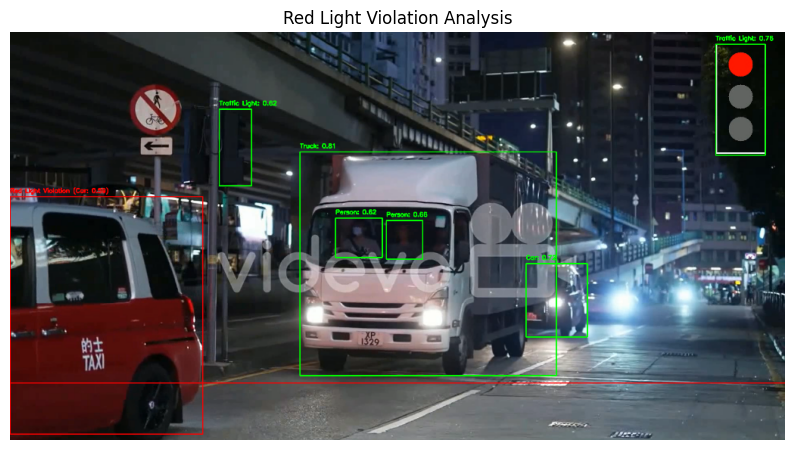

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:06:31] "POST /analyze HTTP/1.1" 200 -



0: 352x640 2 Traffic-Reds, 342.3ms
Speed: 18.5ms preprocess, 342.3ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED


0: 352x640 2 Traffic-Reds, 215.1ms
Speed: 8.0ms preprocess, 215.1ms inference, 1.4ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 3 persons, 2 cars, 3 buss, 2 trucks, 2 traffic lights, 2180.3ms
Speed: 6.7ms preprocess, 2180.3ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.82 at [1377, 612, 1516, 731]
Detected Object: Traffic Light: 0.79 at [1747, 30, 1871, 305]
Detected Object: Truck: 0.71 at [719, 302, 1343, 858]
Detected Object: Traffic Light: 0.68 at [520, 202, 600, 388]
Detected Object: Bus: 0.62 at [144, 381, 495, 702]
Detected Object: Person: 0.60 at [819, 475, 912, 567]
Bounding Box [1377, 612, 1516, 731]: Car: 0.82
Bounding Box [1747, 3

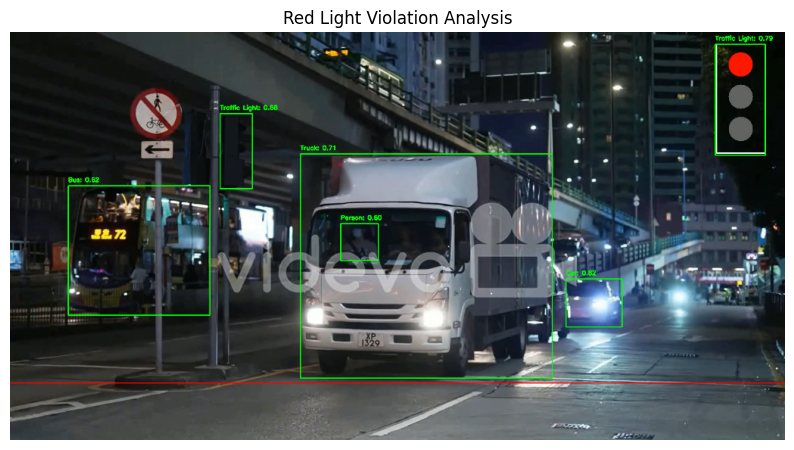

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:06:33] "POST /analyze HTTP/1.1" 200 -


0: 352x640 1 Traffic-Red, 1 Traffic-Yellow, 503.2ms
Speed: 25.1ms preprocess, 503.2ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: YELLOW
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 3 cars, 1 bus, 1 truck, 2 traffic lights, 2597.3ms
Speed: 8.8ms preprocess, 2597.3ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.83 at [717, 301, 1343, 857]
Detected Object: Car: 0.81 at [0, 659, 70, 1000]
Detected Object: Car: 0.79 at [1382, 614, 1524, 728]
Detected Object: Traffic Light: 0.77 at [1747, 30, 1871, 304]
Detected Object: Traffic Light: 0.66 at [519, 195, 598, 385]
Detected Object: Bus: 0.59 at [141, 381, 496, 700]
Detected Object: Person: 0.59 at [816, 468, 921, 565]
Bounding Box [717, 301, 1343, 857]: Truck: 0.83
Bounding Box [0, 659, 70, 1000]: Red Light Violation (Car: 0.81)
Bounding Box [1382, 614, 1524, 728]: Car: 0.79
Bounding Box [1747, 30, 1871, 304]: Tra

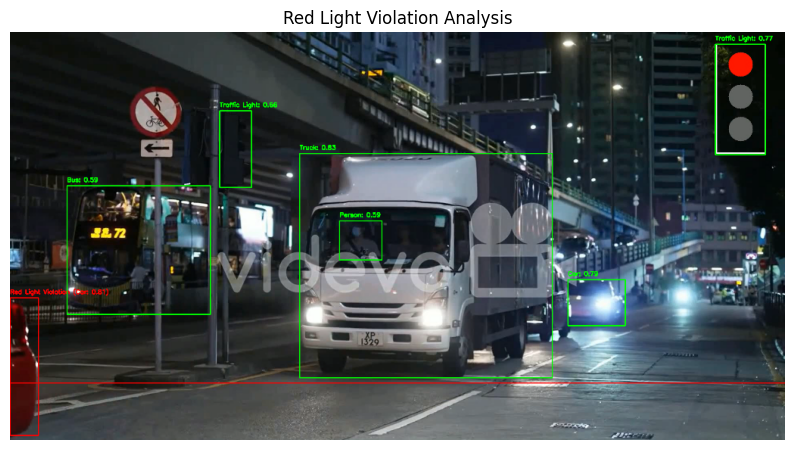

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:06:36] "POST /analyze HTTP/1.1" 200 -





0: 352x640 2 Traffic-Reds, 454.8ms
Speed: 12.9ms preprocess, 454.8ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Current Detected State: RED
Detected traffic light state: RED


0: 352x640 2 Traffic-Reds, 518.4ms
Speed: 28.2ms preprocess, 518.4ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED


0: 352x640 1 Traffic-Red, 485.7ms
Speed: 19.4ms preprocess, 485.7ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED


0: 352x640 1 Traffic-Red, 435.9ms
Speed: 30.1ms preprocess, 435.9ms inference, 1.4ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 3 persons, 3 cars, 1 bus, 1 truck, 2 traffic lights, 3691.8ms
Speed: 4.6ms preprocess, 3691.8ms inference, 7.1ms postprocess per image at shape (1, 3, 352, 640)
Detected

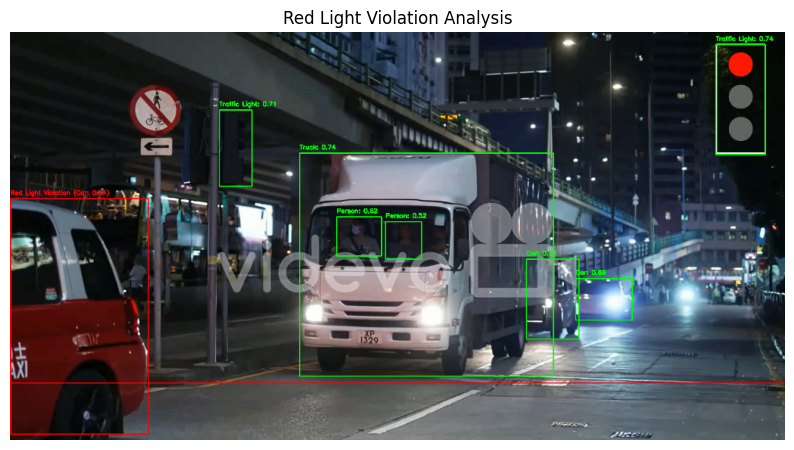

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:06:40] "POST /analyze HTTP/1.1" 200 -


0: 352x640 5 persons, 1 car, 4 buss, 1 truck, 2 traffic lights, 2077.0ms
Speed: 19.9ms preprocess, 2077.0ms inference, 2.2ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.84 at [1377, 618, 1511, 736]
Detected Object: Traffic Light: 0.82 at [1748, 30, 1871, 304]
Detected Object: Truck: 0.73 at [719, 304, 1349, 861]
Detected Object: Person: 0.64 at [820, 473, 913, 568]
Detected Object: Traffic Light: 0.63 at [520, 201, 596, 392]
Detected Object: Bus: 0.53 at [142, 383, 695, 708]
Bounding Box [1377, 618, 1511, 736]: Car: 0.84
Bounding Box [1748, 30, 1871, 304]: Traffic Light: 0.82
Bounding Box [719, 304, 1349, 861]: Truck: 0.73
Bounding Box [820, 473, 913, 568]: Person: 0.64
Bounding Box [520, 201, 596, 392]: Traffic Light: 0.63
Bounding Box [142, 383, 695, 708]: Bus: 0.53


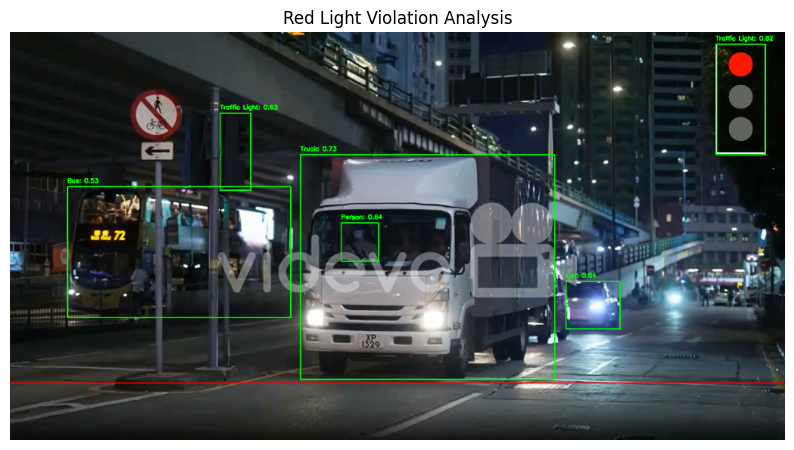

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:06:41] "POST /analyze HTTP/1.1" 200 -


0: 352x640 3 persons, 4 cars, 2 buss, 1 truck, 2 traffic lights, 1539.3ms
Speed: 5.2ms preprocess, 1539.3ms inference, 1.4ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.89 at [0, 441, 181, 999]
Detected Object: Car: 0.77 at [1388, 613, 1523, 724]
Detected Object: Traffic Light: 0.75 at [1748, 30, 1871, 305]
Detected Object: Traffic Light: 0.72 at [518, 193, 599, 384]
Detected Object: Truck: 0.70 at [718, 301, 1342, 855]
Detected Object: Person: 0.70 at [814, 459, 923, 559]
Detected Object: Bus: 0.64 at [145, 380, 493, 693]
Detected Object: Car: 0.59 at [1279, 568, 1396, 764]
Detected Object: Bus: 0.52 at [718, 299, 1342, 856]
Bounding Box [0, 441, 181, 999]: Red Light Violation (Car: 0.89)
Bounding Box [1388, 613, 1523, 724]: Car: 0.77
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.75
Bounding Box [518, 193, 599, 384]: Traffic Light: 0.72
Bounding Box [718, 301, 1342, 855]: Truck: 0.70
Bounding Box [814, 459, 923, 559]: Person: 0.70
Bounding Box [145, 

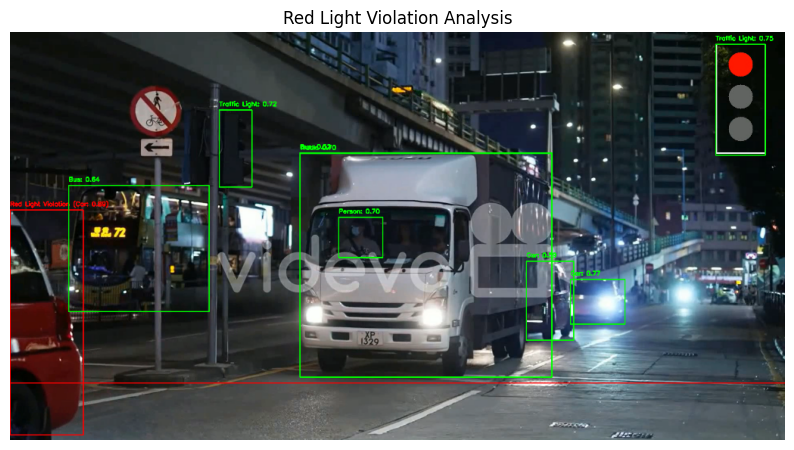

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:06:43] "POST /analyze HTTP/1.1" 200 -



0: 352x640 1 Traffic-Red, 299.2ms
Speed: 6.3ms preprocess, 299.2ms inference, 1.4ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 1 person, 3 cars, 2 trucks, 2 traffic lights, 1848.3ms
Speed: 7.7ms preprocess, 1848.3ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.90 at [804, 324, 1367, 831]
Detected Object: Car: 0.77 at [0, 438, 645, 999]
Detected Object: Traffic Light: 0.75 at [1748, 30, 1871, 304]
Detected Object: Car: 0.60 at [1341, 577, 1464, 742]
Detected Object: Person: 0.53 at [896, 476, 986, 558]
Bounding Box [804, 324, 1367, 831]: Truck: 0.90
Bounding Box [0, 438, 645, 999]: Red Light Violation (Car: 0.77)
Bounding Box [1748, 30, 1871, 304]: Traffic Light: 0.75
Bounding Box [1341, 577, 1464, 742]: Car: 0.60
Bounding Box [896, 476, 986, 558]: Person: 0.53


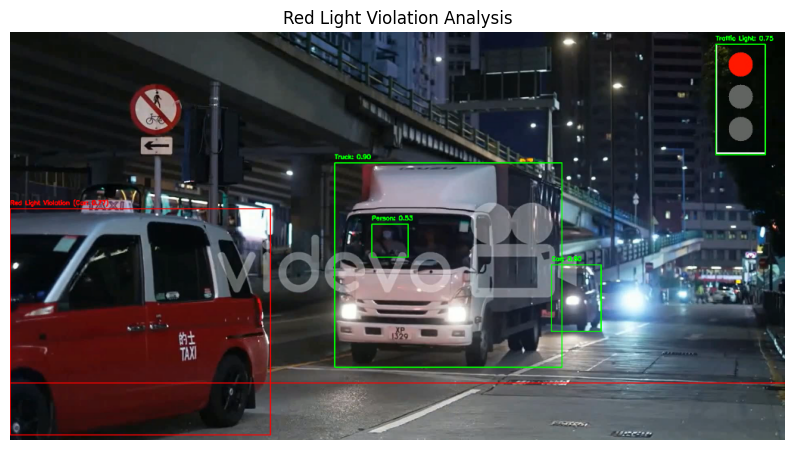

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:06:45] "POST /analyze HTTP/1.1" 200 -


0: 352x640 3 persons, 4 cars, 2 trucks, 2 traffic lights, 1607.3ms
Speed: 4.7ms preprocess, 1607.3ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.80 at [767, 310, 1357, 841]
Detected Object: Traffic Light: 0.78 at [1748, 30, 1871, 304]
Detected Object: Car: 0.77 at [1307, 572, 1454, 746]
Detected Object: Car: 0.70 at [1, 421, 595, 995]
Detected Object: Person: 0.70 at [853, 472, 958, 564]
Detected Object: Traffic Light: 0.54 at [519, 190, 595, 381]
Bounding Box [767, 310, 1357, 841]: Truck: 0.80
Bounding Box [1748, 30, 1871, 304]: Traffic Light: 0.78
Bounding Box [1307, 572, 1454, 746]: Car: 0.77
Bounding Box [1, 421, 595, 995]: Red Light Violation (Car: 0.70)
Bounding Box [853, 472, 958, 564]: Person: 0.70
Bounding Box [519, 190, 595, 381]: Traffic Light: 0.54


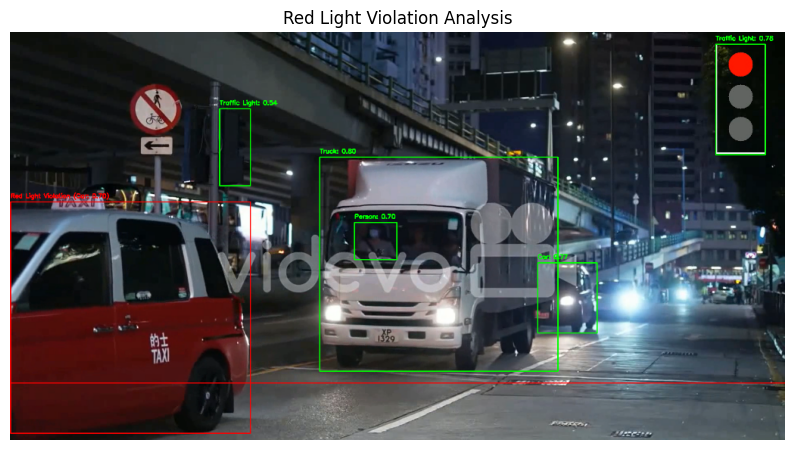

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:06:47] "POST /analyze HTTP/1.1" 200 -





0: 352x640 2 Traffic-Reds, 357.1ms
Speed: 14.3ms preprocess, 357.1ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 1 Traffic-Red, 307.6ms
Speed: 4.1ms preprocess, 307.6ms inference, 7.1ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 1 Traffic-Red, 313.9ms
Speed: 12.4ms preprocess, 313.9ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 1 person, 5 cars, 2 buss, 1 truck, 1 traffic light, 2504.6ms
Speed: 16.1ms preprocess, 2504.6ms inference, 1.8ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Bus: 0.85 at [155, 365, 492, 552]
Detected Object: Car: 0.82 at [0, 451, 853, 991]
Detected Object: Truck: 0.82 at [978, 361, 1433, 786]
Detected Object: Bus: 0.78 at [978, 361, 1433, 787]
Det

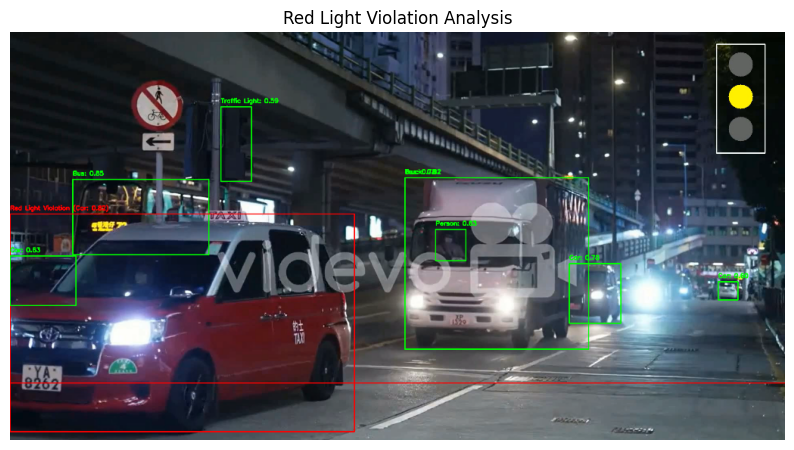

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:06:49] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 persons, 4 cars, 1 bus, 1 truck, 2 traffic lights, 2234.7ms
Speed: 14.9ms preprocess, 2234.7ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.93 at [0, 416, 268, 997]
Detected Object: Car: 0.81 at [1394, 615, 1534, 723]
Detected Object: Traffic Light: 0.77 at [1748, 31, 1871, 304]
Detected Object: Truck: 0.75 at [717, 300, 1341, 854]
Detected Object: Traffic Light: 0.74 at [517, 193, 599, 382]
Detected Object: Person: 0.72 at [800, 458, 914, 560]
Detected Object: Car: 0.65 at [1280, 563, 1401, 764]
Bounding Box [0, 416, 268, 997]: Red Light Violation (Car: 0.93)
Bounding Box [1394, 615, 1534, 723]: Car: 0.81
Bounding Box [1748, 31, 1871, 304]: Traffic Light: 0.77
Bounding Box [717, 300, 1341, 854]: Truck: 0.75
Bounding Box [517, 193, 599, 382]: Traffic Light: 0.74
Bounding Box [800, 458, 914, 560]: Person: 0.72
Bounding Box [1280, 563, 1401, 764]: Car: 0.65


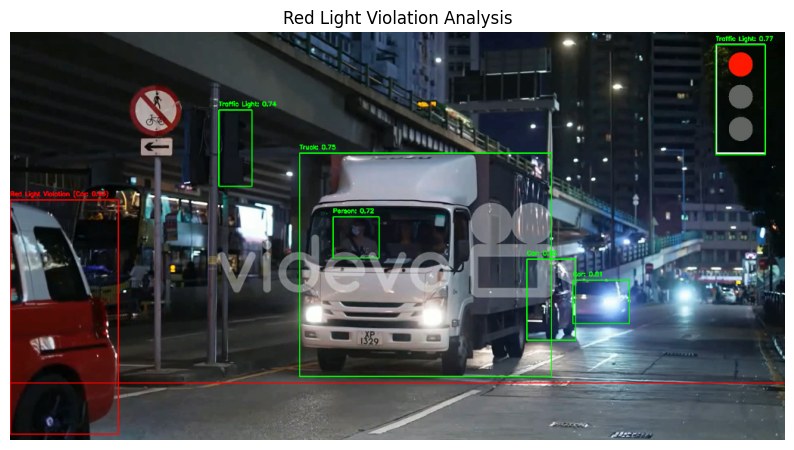

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:06:52] "POST /analyze HTTP/1.1" 200 -


0: 352x640 1 person, 3 cars, 1 bus, 2 trucks, 2 traffic lights, 2421.2ms
Speed: 14.6ms preprocess, 2421.2ms inference, 4.0ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.88 at [854, 336, 1391, 822]
Detected Object: Traffic Light: 0.74 at [1748, 30, 1871, 305]
Detected Object: Bus: 0.72 at [852, 334, 1391, 822]
Detected Object: Car: 0.72 at [1334, 578, 1478, 739]
Detected Object: Car: 0.69 at [0, 446, 693, 998]
Detected Object: Person: 0.54 at [935, 478, 1020, 561]
Bounding Box [854, 336, 1391, 822]: Truck: 0.88
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.74
Bounding Box [852, 334, 1391, 822]: Bus: 0.72
Bounding Box [1334, 578, 1478, 739]: Car: 0.72
Bounding Box [0, 446, 693, 998]: Red Light Violation (Car: 0.69)
Bounding Box [935, 478, 1020, 561]: Person: 0.54


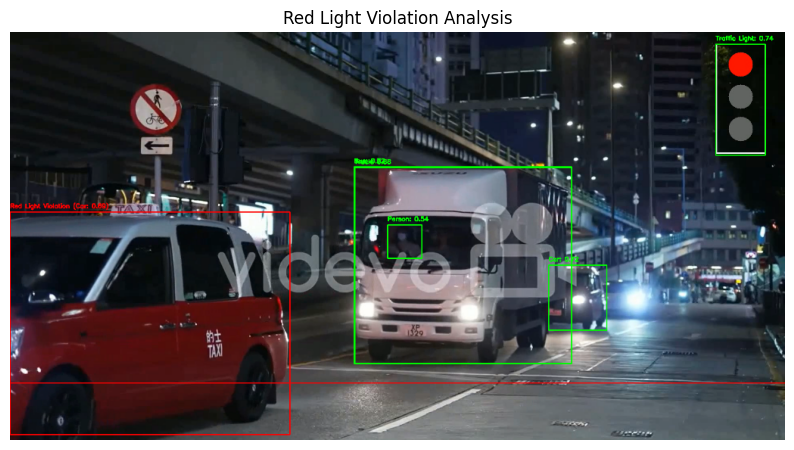

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:06:54] "POST /analyze HTTP/1.1" 200 -



0: 352x640 1 Traffic-Red, 411.9ms
Speed: 8.0ms preprocess, 411.9ms inference, 2.0ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 5 persons, 1 car, 2 buss, 1 truck, 2 traffic lights, 2916.3ms
Speed: 4.0ms preprocess, 2916.3ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.83 at [1376, 618, 1511, 737]
Detected Object: Traffic Light: 0.82 at [1748, 30, 1872, 304]
Detected Object: Truck: 0.78 at [719, 304, 1350, 861]
Detected Object: Bus: 0.65 at [142, 383, 698, 709]
Detected Object: Traffic Light: 0.63 at [520, 203, 598, 392]
Detected Object: Person: 0.61 at [820, 472, 913, 568]
Bounding Box [1376, 618, 1511, 737]: Car: 0.83
Bounding Box [1748, 30, 1872, 304]: Traffic Light: 0.82
Bounding Box [719, 304, 1350, 861]: Truck: 0.78
Bounding Box [142, 383, 698, 709]: Bus: 0.65
Bounding Box [520, 203, 598, 392]: Traffic Light: 0.63
Bounding Box [820, 472, 913, 568]: Person: 0.6

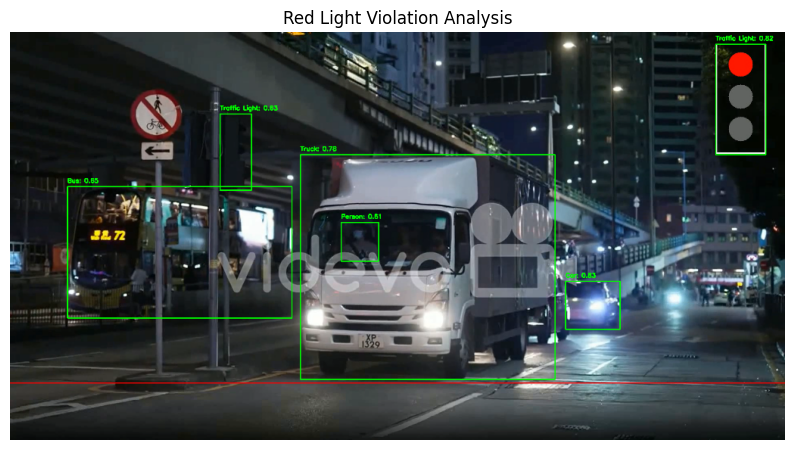

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:06:57] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 persons, 3 cars, 1 truck, 2 traffic lights, 2047.2ms
Speed: 3.6ms preprocess, 2047.2ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.92 at [1, 413, 412, 996]
Detected Object: Truck: 0.81 at [716, 299, 1345, 854]
Detected Object: Car: 0.80 at [1277, 567, 1420, 757]
Detected Object: Traffic Light: 0.74 at [1748, 30, 1870, 304]
Detected Object: Person: 0.74 at [802, 459, 920, 561]
Detected Object: Car: 0.72 at [1410, 611, 1544, 713]
Detected Object: Traffic Light: 0.68 at [519, 190, 599, 382]
Detected Object: Person: 0.52 at [929, 466, 1019, 563]
Bounding Box [1, 413, 412, 996]: Red Light Violation (Car: 0.92)
Bounding Box [716, 299, 1345, 854]: Truck: 0.81
Bounding Box [1277, 567, 1420, 757]: Car: 0.80
Bounding Box [1748, 30, 1870, 304]: Traffic Light: 0.74
Bounding Box [802, 459, 920, 561]: Person: 0.74
Bounding Box [1410, 611, 1544, 713]: Car: 0.72
Bounding Box [519, 190, 599, 382]: Traffic Light: 0.68
Bounding Box [929, 466, 1019

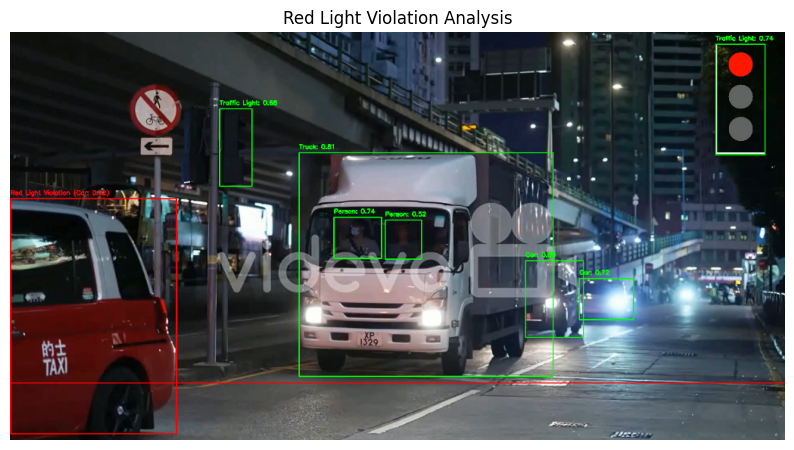

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:06:59] "POST /analyze HTTP/1.1" 200 -


0: 352x640 1 person, 2 cars, 1 truck, 2 traffic lights, 1723.5ms
Speed: 5.6ms preprocess, 1723.5ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.84 at [1, 428, 541, 997]
Detected Object: Truck: 0.83 at [735, 305, 1354, 846]
Detected Object: Traffic Light: 0.77 at [1748, 30, 1871, 304]
Detected Object: Car: 0.68 at [1285, 572, 1442, 751]
Detected Object: Person: 0.65 at [829, 477, 934, 560]
Detected Object: Traffic Light: 0.57 at [517, 190, 600, 382]
Bounding Box [1, 428, 541, 997]: Red Light Violation (Car: 0.84)
Bounding Box [735, 305, 1354, 846]: Truck: 0.83
Bounding Box [1748, 30, 1871, 304]: Traffic Light: 0.77
Bounding Box [1285, 572, 1442, 751]: Car: 0.68
Bounding Box [829, 477, 934, 560]: Person: 0.65
Bounding Box [517, 190, 600, 382]: Traffic Light: 0.57



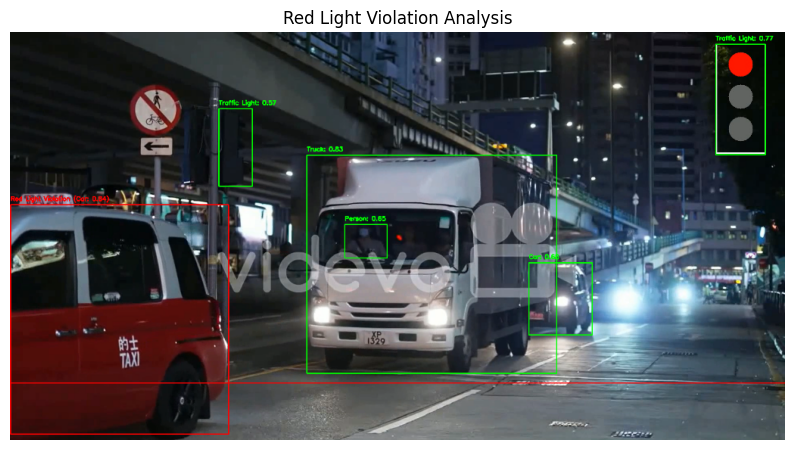

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:01] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 Traffic-Reds, 467.2ms
Speed: 4.1ms preprocess, 467.2ms inference, 14.4ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Current Detected State: RED
Detected traffic light state: RED


0: 352x640 2 Traffic-Reds, 215.8ms
Speed: 15.9ms preprocess, 215.8ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 3 cars, 1 bus, 2 trucks, 2 traffic lights, 2407.4ms
Speed: 5.0ms preprocess, 2407.4ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.84 at [1351, 578, 1489, 736]
Detected Object: Bus: 0.77 at [895, 349, 1405, 812]
Detected Object: Traffic Light: 0.76 at [1748, 30, 1871, 305]
Detected Object: Truck: 0.69 at [0, 433, 743, 998]
Detected Object: Car: 0.62 at [1480, 611, 1586, 699]
Detected Object: Person: 0.57 at [975, 485, 1052, 555]
Detected Object: Traffic Light: 0.56 at [519, 189, 601, 379]
Detected Object: 

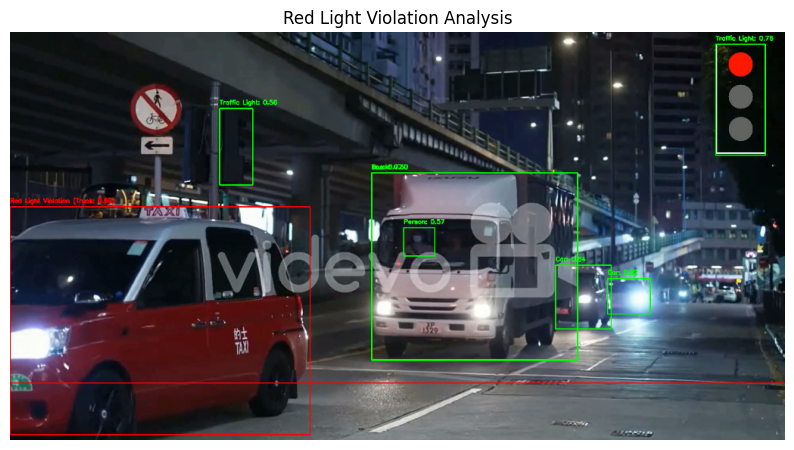

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:04] "POST /analyze HTTP/1.1" 200 -


0: 352x640 1 person, 3 cars, 1 bus, 1 truck, 2 traffic lights, 2520.0ms
Speed: 4.1ms preprocess, 2520.0ms inference, 5.1ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.86 at [718, 301, 1345, 857]
Detected Object: Car: 0.78 at [1382, 613, 1524, 727]
Detected Object: Car: 0.78 at [0, 673, 55, 998]
Detected Object: Traffic Light: 0.77 at [1747, 30, 1871, 304]
Detected Object: Traffic Light: 0.64 at [520, 199, 599, 385]
Detected Object: Bus: 0.61 at [142, 381, 496, 700]
Detected Object: Person: 0.59 at [815, 467, 922, 566]
Bounding Box [718, 301, 1345, 857]: Truck: 0.86
Bounding Box [1382, 613, 1524, 727]: Car: 0.78
Bounding Box [0, 673, 55, 998]: Red Light Violation (Car: 0.78)
Bounding Box [1747, 30, 1871, 304]: Traffic Light: 0.77
Bounding Box [520, 199, 599, 385]: Traffic Light: 0.64
Bounding Box [142, 381, 496, 700]: Bus: 0.61
Bounding Box [815, 467, 922, 566]: Person: 0.59


0: 352x640 2 Traffic-Reds, 655.3ms
Speed: 15.9ms preprocess, 655.3ms inference, 9

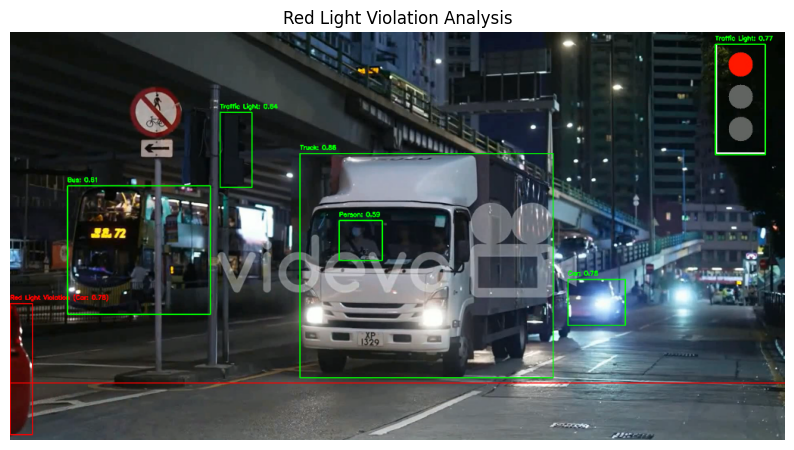

0: 352x640 1 Traffic-Red, 1 Traffic-Yellow, 866.7ms
Speed: 27.4ms preprocess, 866.7ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: YELLOW
Current Detected State: RED
Detected traffic light state: RED



INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:07] "POST /analyze HTTP/1.1" 200 -


0: 352x640 1 person, 4 cars, 1 bus, 1 truck, 2 traffic lights, 3191.8ms
Speed: 3.7ms preprocess, 3191.8ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.90 at [0, 447, 786, 997]
Detected Object: Truck: 0.85 at [930, 353, 1415, 800]
Detected Object: Car: 0.84 at [1368, 576, 1501, 727]
Detected Object: Traffic Light: 0.79 at [1748, 30, 1871, 304]
Detected Object: Car: 0.72 at [1741, 621, 1812, 667]
Detected Object: Bus: 0.72 at [930, 353, 1413, 799]
Detected Object: Traffic Light: 0.65 at [523, 183, 601, 374]
Detected Object: Car: 0.51 at [1492, 608, 1591, 696]
Bounding Box [0, 447, 786, 997]: Red Light Violation (Car: 0.90)
Bounding Box [930, 353, 1415, 800]: Truck: 0.85
Bounding Box [1368, 576, 1501, 727]: Car: 0.84
Bounding Box [1748, 30, 1871, 304]: Traffic Light: 0.79
Bounding Box [1741, 621, 1812, 667]: Car: 0.72
Bounding Box [930, 353, 1413, 799]: Bus: 0.72
Bounding Box [523, 183, 601, 374]: Traffic Light: 0.65
Bounding Box [1492, 608, 159

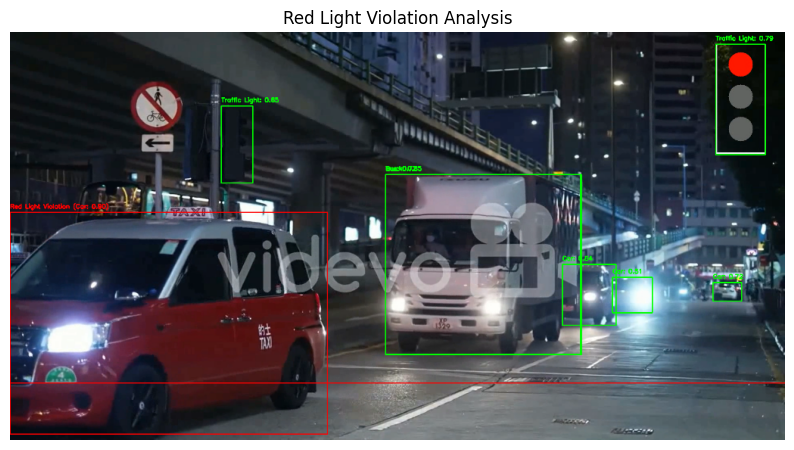

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:09] "POST /analyze HTTP/1.1" 200 -


0: 352x640 3 persons, 2 cars, 1 bus, 2 trucks, 2 traffic lights, 2422.7ms
Speed: 3.8ms preprocess, 2422.7ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.81 at [1378, 615, 1516, 732]
Detected Object: Traffic Light: 0.80 at [1747, 30, 1872, 305]
Detected Object: Truck: 0.78 at [719, 302, 1344, 859]
Detected Object: Traffic Light: 0.69 at [520, 201, 600, 388]
Detected Object: Bus: 0.66 at [144, 381, 497, 701]
Detected Object: Person: 0.58 at [818, 474, 912, 567]
Bounding Box [1378, 615, 1516, 732]: Car: 0.81
Bounding Box [1747, 30, 1872, 305]: Traffic Light: 0.80
Bounding Box [719, 302, 1344, 859]: Truck: 0.78
Bounding Box [520, 201, 600, 388]: Traffic Light: 0.69
Bounding Box [144, 381, 497, 701]: Bus: 0.66
Bounding Box [818, 474, 912, 567]: Person: 0.58



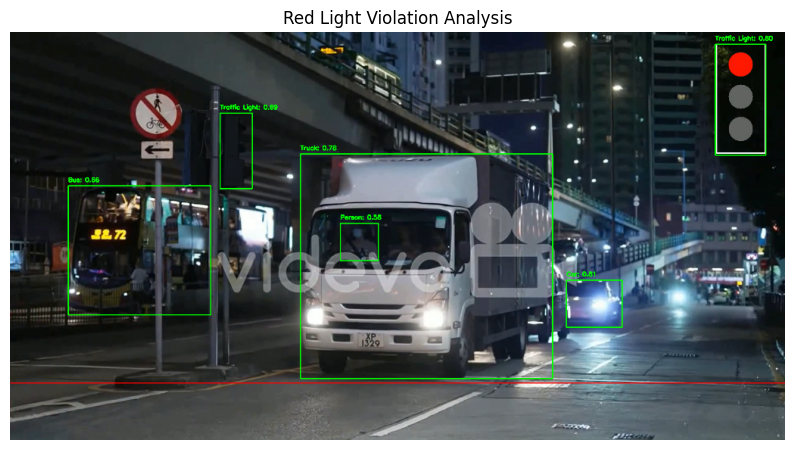

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:12] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 Traffic-Reds, 595.1ms
Speed: 9.6ms preprocess, 595.1ms inference, 4.5ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Current Detected State: RED
Detected traffic light state: RED


0: 352x640 2 Traffic-Reds, 341.9ms
Speed: 7.8ms preprocess, 341.9ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 2 cars, 1 truck, 2 traffic lights, 3012.8ms
Speed: 3.8ms preprocess, 3012.8ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.86 at [0, 413, 469, 997]
Detected Object: Truck: 0.83 at [717, 295, 1352, 853]
Detected Object: Car: 0.77 at [1279, 573, 1429, 756]
Detected Object: Traffic Light: 0.76 at [1748, 30, 1871, 305]
Detected Object: Person: 0.66 at [931, 467, 1023, 563]
Detected Object: Traffic Light: 0.61 at [518, 191, 597, 381]
Detected Object: Person: 0.57 at [807, 460, 921, 559]
Bounding Box [0, 413, 469,

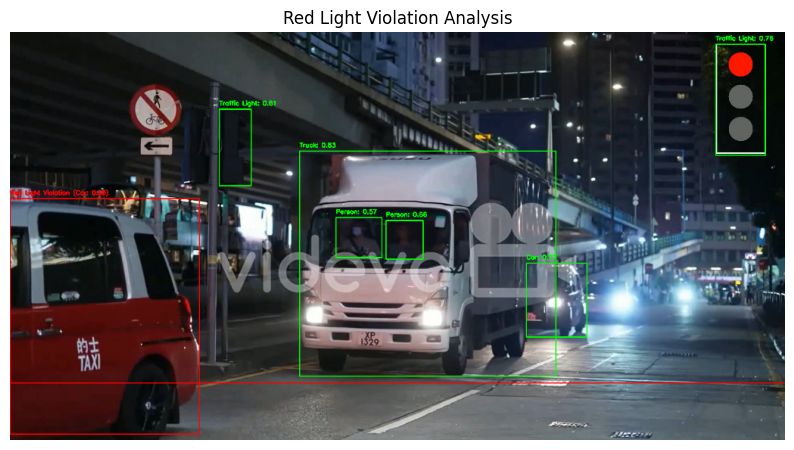

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:15] "POST /analyze HTTP/1.1" 200 -


0: 352x640 3 persons, 3 cars, 1 bus, 1 truck, 2 traffic lights, 2411.8ms
Speed: 10.1ms preprocess, 2411.8ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.93 at [1, 413, 334, 998]
Detected Object: Traffic Light: 0.75 at [1748, 31, 1870, 305]
Detected Object: Car: 0.70 at [1279, 563, 1408, 761]
Detected Object: Truck: 0.70 at [717, 300, 1346, 853]
Detected Object: Traffic Light: 0.70 at [518, 193, 600, 382]
Detected Object: Car: 0.64 at [1401, 611, 1540, 710]
Detected Object: Person: 0.62 at [808, 458, 920, 554]
Detected Object: Bus: 0.50 at [718, 298, 1346, 854]
Bounding Box [1, 413, 334, 998]: Red Light Violation (Car: 0.93)
Bounding Box [1748, 31, 1870, 305]: Traffic Light: 0.75
Bounding Box [1279, 563, 1408, 761]: Car: 0.70
Bounding Box [717, 300, 1346, 853]: Truck: 0.70
Bounding Box [518, 193, 600, 382]: Traffic Light: 0.70
Bounding Box [1401, 611, 1540, 710]: Car: 0.64
Bounding Box [808, 458, 920, 554]: Person: 0.62
Bounding Box [718, 298,

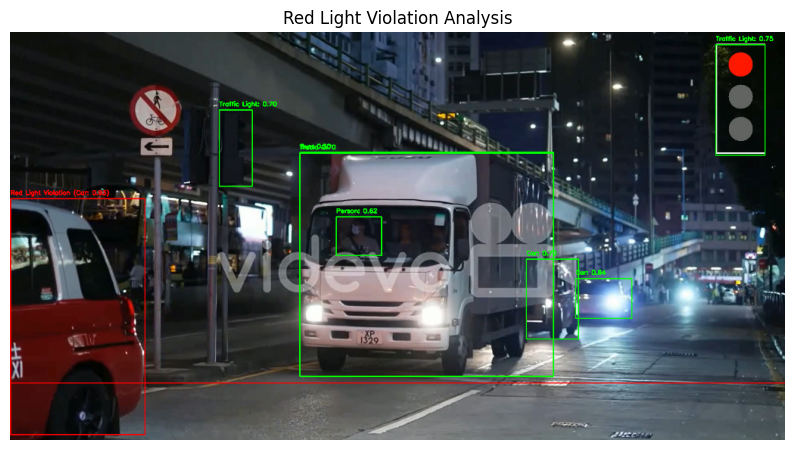

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:17] "POST /analyze HTTP/1.1" 200 -




0: 352x640 2 Traffic-Reds, 451.6ms
Speed: 10.4ms preprocess, 451.6ms inference, 7.9ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 5 persons, 1 car, 4 buss, 1 truck, 2 traffic lights, 3062.0ms
Speed: 4.0ms preprocess, 3062.0ms inference, 14.8ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.84 at [1377, 618, 1511, 736]
Detected Object: Traffic Light: 0.82 at [1748, 30, 1871, 304]
Detected Object: Truck: 0.73 at [719, 304, 1349, 861]
Detected Object: Traffic Light: 0.67 at [520, 202, 597, 392]
Detected Object: Person: 0.64 at [820, 473, 913, 568]
Detected Object: Bus: 0.54 at [142, 382, 692, 709]
Bounding Box [1377, 618, 1511, 736]: Car: 0.84
Bounding Box [1748, 30, 1871, 304]: Traffic Light: 0.82
Bounding Box [719, 304, 1349, 861]: Truck: 0.73
Bounding Box [520, 202, 597, 392]: Traffic Light: 0.67
Bounding Box [820, 473, 913, 568]: Person: 0.64
Bounding Box [142, 382, 692, 709]: Bus:

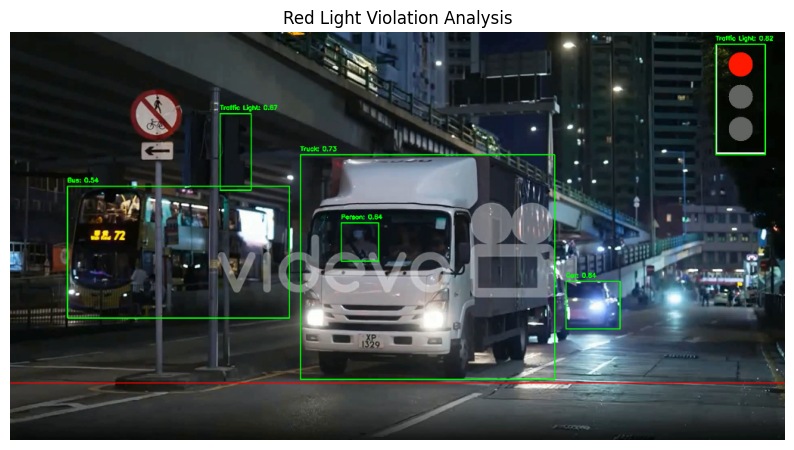

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:20] "POST /analyze HTTP/1.1" 200 -



0: 352x640 1 Traffic-Red, 413.3ms
Speed: 8.9ms preprocess, 413.3ms inference, 1.1ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 3 persons, 4 cars, 2 buss, 1 truck, 2 traffic lights, 2506.9ms
Speed: 19.6ms preprocess, 2506.9ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.88 at [0, 455, 169, 999]
Detected Object: Car: 0.78 at [1387, 614, 1524, 725]
Detected Object: Traffic Light: 0.76 at [1748, 30, 1871, 305]
Detected Object: Truck: 0.74 at [718, 300, 1342, 855]
Detected Object: Traffic Light: 0.72 at [518, 193, 599, 384]
Detected Object: Bus: 0.70 at [143, 380, 493, 695]
Detected Object: Person: 0.70 at [814, 460, 923, 559]
Bounding Box [0, 455, 169, 999]: Red Light Violation (Car: 0.88)
Bounding Box [1387, 614, 1524, 725]: Car: 0.78
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.76
Bounding Box [718, 300, 1342, 855]: Truck: 0.74
Bounding Box [518, 193, 599, 3

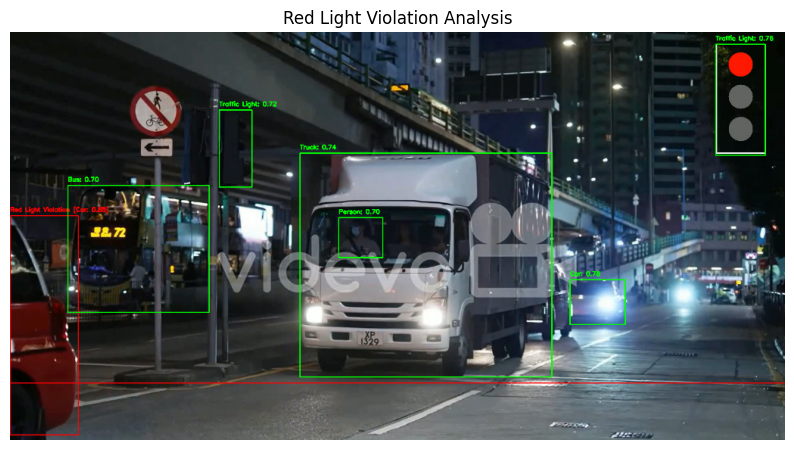

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:22] "POST /analyze HTTP/1.1" 200 -


0: 352x640 1 person, 3 cars, 1 truck, 2 traffic lights, 2287.5ms
Speed: 3.6ms preprocess, 2287.5ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.92 at [803, 323, 1366, 831]
Detected Object: Car: 0.83 at [0, 440, 640, 998]
Detected Object: Traffic Light: 0.73 at [1748, 30, 1871, 305]
Detected Object: Car: 0.65 at [1340, 577, 1464, 743]
Detected Object: Traffic Light: 0.53 at [520, 188, 596, 381]
Bounding Box [803, 323, 1366, 831]: Truck: 0.92
Bounding Box [0, 440, 640, 998]: Red Light Violation (Car: 0.83)
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.73
Bounding Box [1340, 577, 1464, 743]: Car: 0.65
Bounding Box [520, 188, 596, 381]: Traffic Light: 0.53


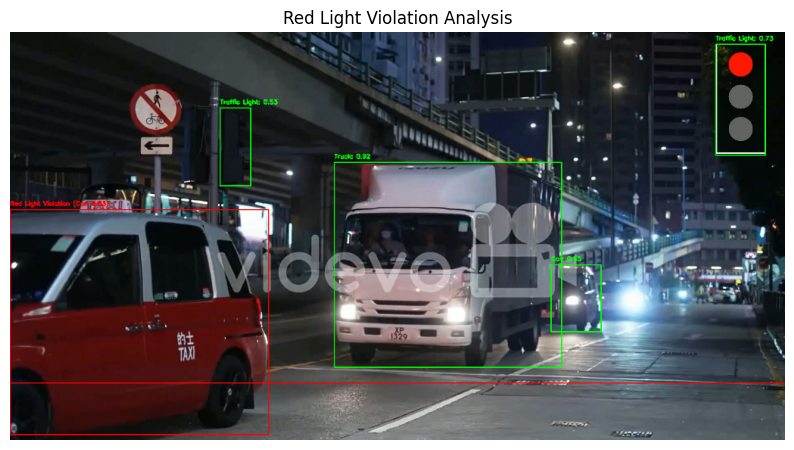

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:25] "POST /analyze HTTP/1.1" 200 -


0: 352x640 3 persons, 3 cars, 1 truck, 2 traffic lights, 2319.9ms
Speed: 6.5ms preprocess, 2319.9ms inference, 3.3ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.84 at [1, 423, 589, 996]
Detected Object: Truck: 0.82 at [764, 310, 1355, 841]
Detected Object: Car: 0.79 at [1305, 573, 1453, 747]
Detected Object: Traffic Light: 0.77 at [1748, 30, 1871, 304]
Detected Object: Person: 0.72 at [848, 471, 956, 563]
Detected Object: Person: 0.53 at [1057, 494, 1118, 583]
Bounding Box [1, 423, 589, 996]: Red Light Violation (Car: 0.84)
Bounding Box [764, 310, 1355, 841]: Truck: 0.82
Bounding Box [1305, 573, 1453, 747]: Car: 0.79
Bounding Box [1748, 30, 1871, 304]: Traffic Light: 0.77
Bounding Box [848, 471, 956, 563]: Person: 0.72
Bounding Box [1057, 494, 1118, 583]: Person: 0.53


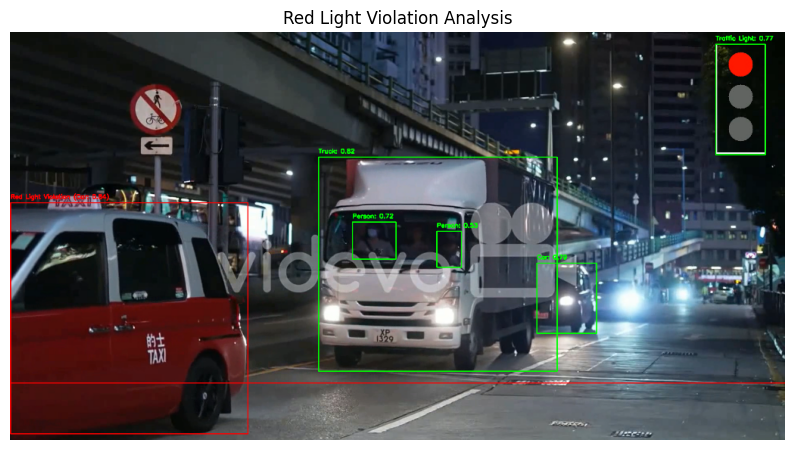

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:27] "POST /analyze HTTP/1.1" 200 -


0: 352x640 1 person, 5 cars, 2 buss, 1 truck, 1 traffic light, 2375.8ms
Speed: 3.9ms preprocess, 2375.8ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Bus: 0.83 at [156, 365, 493, 550]
Detected Object: Truck: 0.81 at [976, 360, 1431, 788]
Detected Object: Bus: 0.79 at [975, 360, 1431, 788]
Detected Object: Car: 0.78 at [1386, 573, 1512, 722]
Detected Object: Car: 0.78 at [0, 448, 842, 994]
Detected Object: Person: 0.63 at [1047, 487, 1125, 570]
Detected Object: Car: 0.61 at [1754, 619, 1803, 663]
Detected Object: Traffic Light: 0.57 at [522, 185, 599, 371]
Bounding Box [156, 365, 493, 550]: Bus: 0.83
Bounding Box [976, 360, 1431, 788]: Truck: 0.81
Bounding Box [975, 360, 1431, 788]: Bus: 0.79
Bounding Box [1386, 573, 1512, 722]: Car: 0.78
Bounding Box [0, 448, 842, 994]: Red Light Violation (Car: 0.78)
Bounding Box [1047, 487, 1125, 570]: Person: 0.63
Bounding Box [1754, 619, 1803, 663]: Car: 0.61
Bounding Box [522, 185, 599, 371]: Traffic Light: 0.

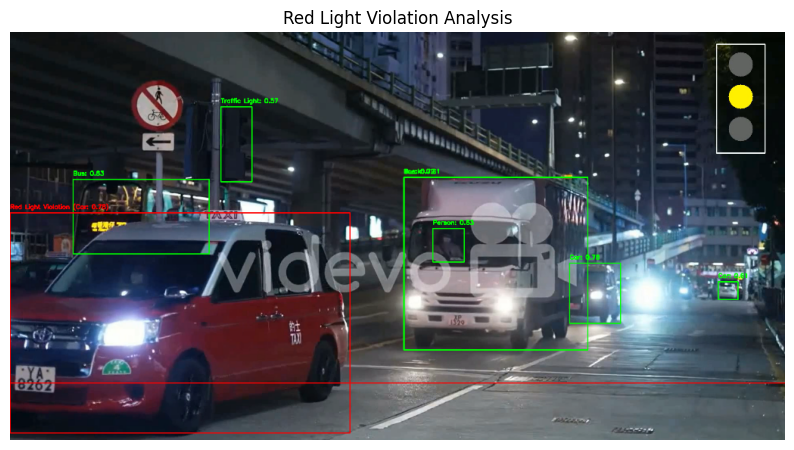

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:30] "POST /analyze HTTP/1.1" 200 -


0: 352x640 1 person, 4 cars, 2 buss, 1 truck, 2 traffic lights, 2577.5ms
Speed: 3.9ms preprocess, 2577.5ms inference, 2.0ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.91 at [1, 421, 257, 996]
Detected Object: Car: 0.81 at [1393, 613, 1535, 724]
Detected Object: Traffic Light: 0.77 at [1748, 30, 1871, 305]
Detected Object: Traffic Light: 0.70 at [518, 191, 599, 383]
Detected Object: Person: 0.69 at [796, 458, 917, 560]
Detected Object: Truck: 0.66 at [718, 300, 1341, 854]
Detected Object: Car: 0.62 at [1279, 564, 1401, 764]
Detected Object: Bus: 0.59 at [718, 298, 1342, 856]
Detected Object: Bus: 0.58 at [150, 379, 494, 706]
Bounding Box [1, 421, 257, 996]: Red Light Violation (Car: 0.91)
Bounding Box [1393, 613, 1535, 724]: Car: 0.81
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.77
Bounding Box [518, 191, 599, 383]: Traffic Light: 0.70
Bounding Box [796, 458, 917, 560]: Person: 0.69
Bounding Box [718, 300, 1341, 854]: Truck: 0.66
Bounding Box [1279, 

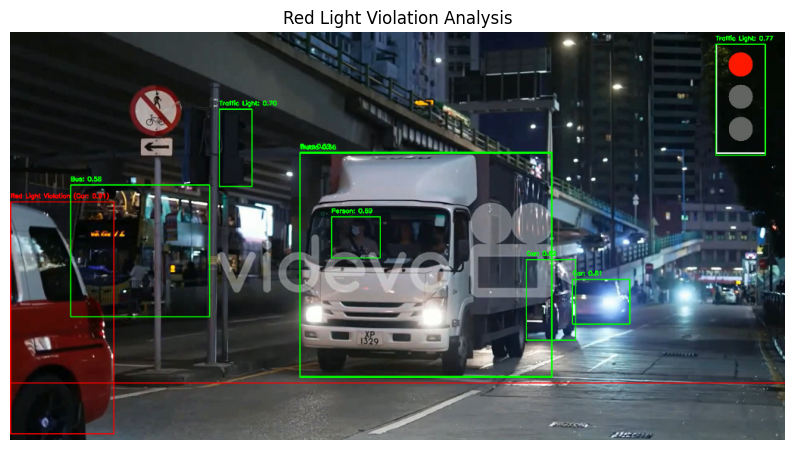

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:32] "POST /analyze HTTP/1.1" 200 -


0: 352x640 1 person, 3 cars, 1 bus, 2 trucks, 2 traffic lights, 2656.1ms
Speed: 5.1ms preprocess, 2656.1ms inference, 6.2ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.88 at [849, 335, 1389, 822]
Detected Object: Traffic Light: 0.76 at [1748, 30, 1871, 305]
Detected Object: Car: 0.69 at [0, 438, 690, 998]
Detected Object: Car: 0.64 at [1334, 578, 1477, 740]
Detected Object: Traffic Light: 0.63 at [518, 189, 599, 381]
Detected Object: Bus: 0.57 at [848, 334, 1390, 821]
Detected Object: Truck: 0.53 at [0, 444, 689, 1000]
Bounding Box [849, 335, 1389, 822]: Truck: 0.88
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.76
Bounding Box [0, 438, 690, 998]: Red Light Violation (Car: 0.69)
Bounding Box [1334, 578, 1477, 740]: Car: 0.64
Bounding Box [518, 189, 599, 381]: Traffic Light: 0.63
Bounding Box [848, 334, 1390, 821]: Bus: 0.57
Bounding Box [0, 444, 689, 1000]: Red Light Violation (Truck: 0.53)


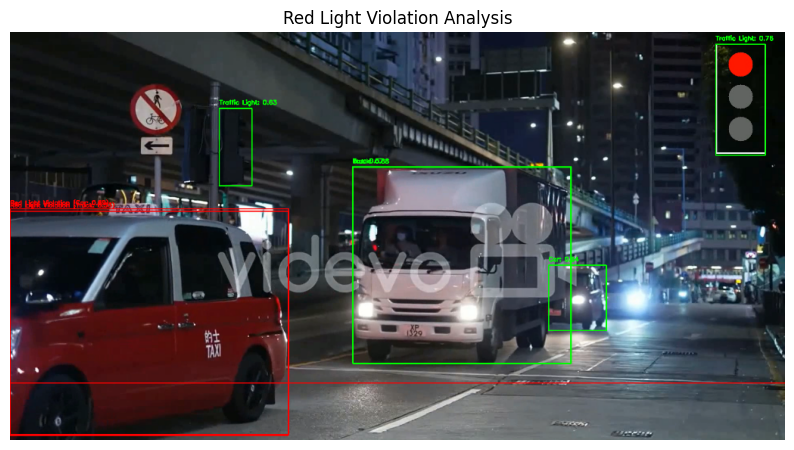

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:35] "POST /analyze HTTP/1.1" 200 -



0: 352x640 2 Traffic-Reds, 362.2ms
Speed: 7.8ms preprocess, 362.2ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 3 cars, 1 truck, 2 traffic lights, 2582.4ms
Speed: 7.3ms preprocess, 2582.4ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.82 at [734, 305, 1353, 847]
Detected Object: Traffic Light: 0.75 at [1748, 30, 1871, 304]
Detected Object: Car: 0.75 at [0, 413, 534, 997]
Detected Object: Person: 0.62 at [826, 479, 935, 564]
Detected Object: Traffic Light: 0.58 at [517, 190, 599, 382]
Detected Object: Car: 0.51 at [1286, 572, 1441, 752]
Bounding Box [734, 305, 1353, 847]: Truck: 0.82
Bounding Box [1748, 30, 1871, 304]: Traffic Light: 0.75
Bounding Box [0, 413, 534, 997]: Red Light Violation (Car: 0.75)
Bounding Box [826, 479, 935, 564]: Person: 0.62
Bounding Box [517, 190, 599, 382]: Traffic Light: 0.58
Bounding Box [1286, 572, 1441, 75

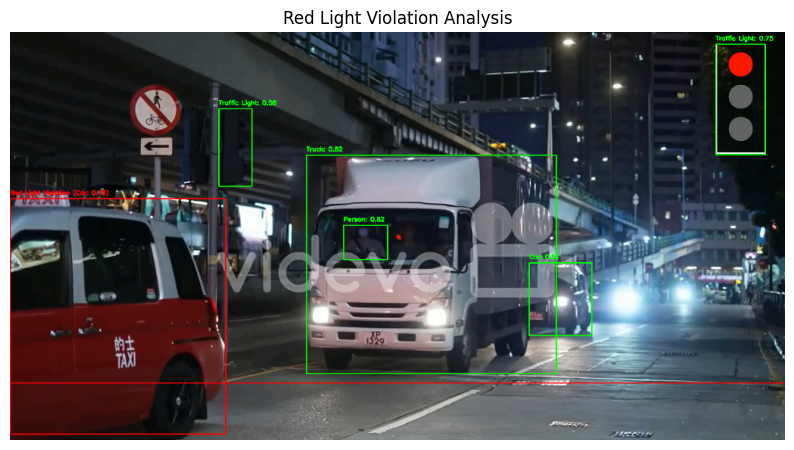

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:37] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 persons, 3 cars, 1 bus, 2 trucks, 2 traffic lights, 2165.5ms
Speed: 4.6ms preprocess, 2165.5ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.82 at [1350, 577, 1489, 737]
Detected Object: Traffic Light: 0.77 at [1748, 30, 1871, 305]
Detected Object: Bus: 0.73 at [892, 348, 1404, 813]
Detected Object: Truck: 0.66 at [0, 435, 740, 999]
Detected Object: Truck: 0.61 at [894, 349, 1405, 814]
Detected Object: Person: 0.57 at [974, 486, 1050, 556]
Detected Object: Traffic Light: 0.56 at [519, 191, 603, 380]
Bounding Box [1350, 577, 1489, 737]: Car: 0.82
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.77
Bounding Box [892, 348, 1404, 813]: Bus: 0.73
Bounding Box [0, 435, 740, 999]: Red Light Violation (Truck: 0.66)
Bounding Box [894, 349, 1405, 814]: Truck: 0.61
Bounding Box [974, 486, 1050, 556]: Person: 0.57
Bounding Box [519, 191, 603, 380]: Traffic Light: 0.56


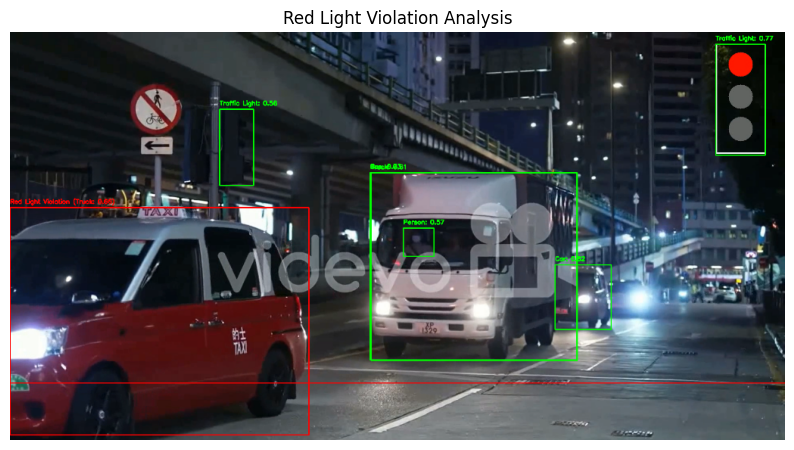

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:40] "POST /analyze HTTP/1.1" 200 -


0: 352x640 5 persons, 1 car, 2 buss, 1 truck, 2 traffic lights, 2346.2ms
Speed: 3.9ms preprocess, 2346.2ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.83 at [1376, 618, 1511, 737]
Detected Object: Traffic Light: 0.82 at [1748, 30, 1872, 304]
Detected Object: Truck: 0.79 at [719, 304, 1350, 861]
Detected Object: Traffic Light: 0.63 at [520, 203, 598, 392]
Detected Object: Bus: 0.63 at [142, 383, 697, 709]
Detected Object: Person: 0.60 at [820, 472, 913, 568]
Detected Object: Person: 0.50 at [295, 565, 339, 711]
Bounding Box [1376, 618, 1511, 737]: Car: 0.83
Bounding Box [1748, 30, 1872, 304]: Traffic Light: 0.82
Bounding Box [719, 304, 1350, 861]: Truck: 0.79
Bounding Box [520, 203, 598, 392]: Traffic Light: 0.63
Bounding Box [142, 383, 697, 709]: Bus: 0.63
Bounding Box [820, 472, 913, 568]: Person: 0.60
Bounding Box [295, 565, 339, 711]: Person: 0.50


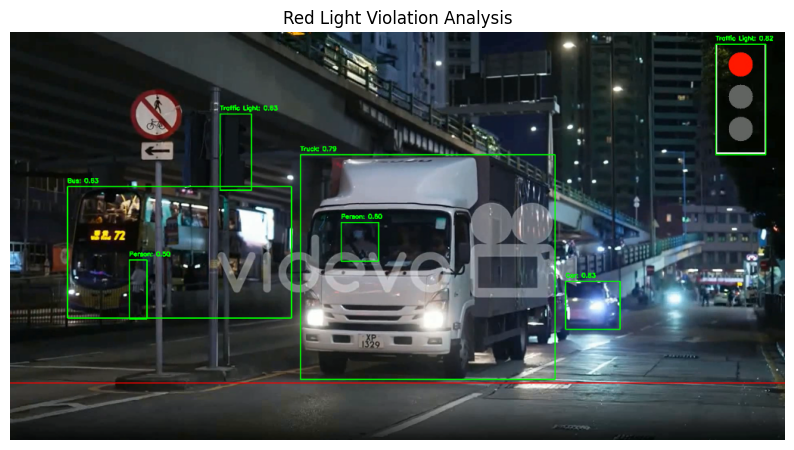

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:42] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 persons, 3 cars, 1 truck, 2 traffic lights, 2291.1ms
Speed: 3.7ms preprocess, 2291.1ms inference, 2.0ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.93 at [1, 413, 403, 996]
Detected Object: Truck: 0.80 at [716, 298, 1342, 854]
Detected Object: Car: 0.79 at [1277, 565, 1418, 757]
Detected Object: Person: 0.75 at [802, 459, 919, 560]
Detected Object: Traffic Light: 0.74 at [1748, 30, 1870, 304]
Detected Object: Car: 0.71 at [1409, 612, 1543, 713]
Detected Object: Traffic Light: 0.69 at [519, 191, 600, 381]
Detected Object: Person: 0.53 at [930, 471, 1017, 564]
Bounding Box [1, 413, 403, 996]: Red Light Violation (Car: 0.93)
Bounding Box [716, 298, 1342, 854]: Truck: 0.80
Bounding Box [1277, 565, 1418, 757]: Car: 0.79
Bounding Box [802, 459, 919, 560]: Person: 0.75
Bounding Box [1748, 30, 1870, 304]: Traffic Light: 0.74
Bounding Box [1409, 612, 1543, 713]: Car: 0.71
Bounding Box [519, 191, 600, 381]: Traffic Light: 0.69
Bounding Box [930, 471, 1017

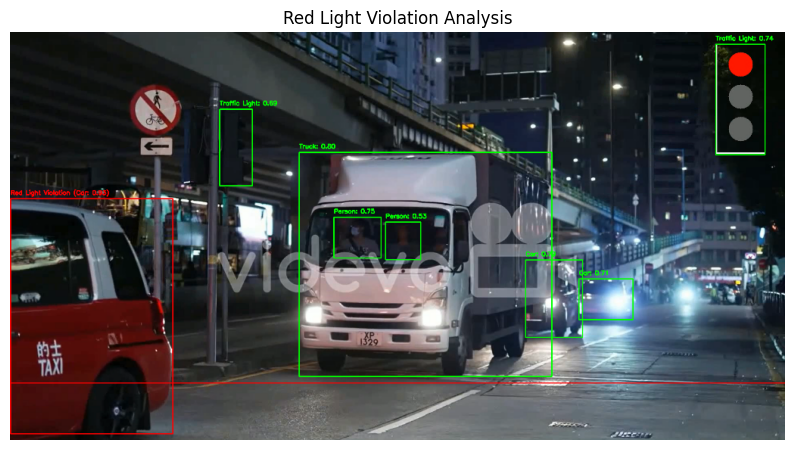

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:44] "POST /analyze HTTP/1.1" 200 -


0: 352x640 3 persons, 3 cars, 1 bus, 1 truck, 2 traffic lights, 2381.7ms
Speed: 4.5ms preprocess, 2381.7ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.87 at [1, 423, 584, 995]
Detected Object: Car: 0.79 at [1301, 571, 1450, 747]
Detected Object: Traffic Light: 0.78 at [1748, 30, 1871, 304]
Detected Object: Truck: 0.74 at [760, 307, 1354, 841]
Detected Object: Person: 0.74 at [845, 470, 950, 560]
Bounding Box [1, 423, 584, 995]: Red Light Violation (Car: 0.87)
Bounding Box [1301, 571, 1450, 747]: Car: 0.79
Bounding Box [1748, 30, 1871, 304]: Traffic Light: 0.78
Bounding Box [760, 307, 1354, 841]: Truck: 0.74
Bounding Box [845, 470, 950, 560]: Person: 0.74


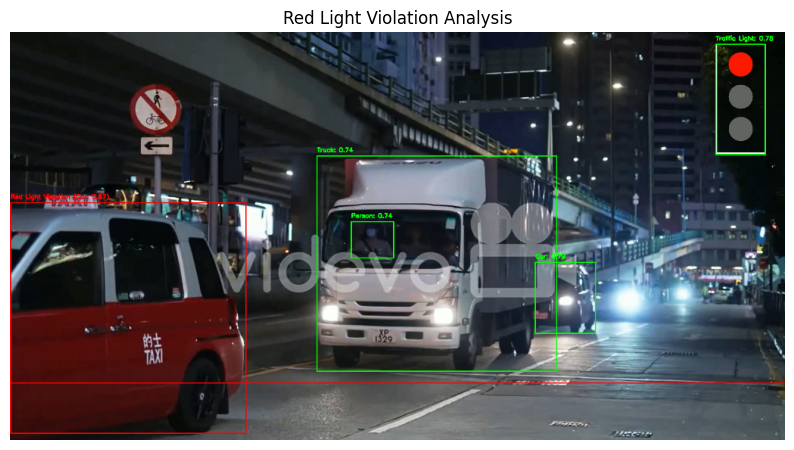

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:07:46] "POST /analyze HTTP/1.1" 200 -



0: 352x640 1 Traffic-Red, 204.1ms
Speed: 4.0ms preprocess, 204.1ms inference, 1.1ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED


0: 352x640 2 Traffic-Reds, 431.7ms
Speed: 10.5ms preprocess, 431.7ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED


0: 352x640 2 Traffic-Reds, 408.5ms
Speed: 3.9ms preprocess, 408.5ms inference, 1.1ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 3 cars, 2 trucks, 2 traffic lights, 2450.5ms
Speed: 4.4ms preprocess, 2450.5ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.85 at [0, 413, 462, 997]
Detected Object: Truck: 0.84 at [716, 295, 1352, 853]
Detected Object: Car: 0.81 at [1277, 572, 1427, 756]
Detected Object: Traffic Light: 0.76 at [1748, 30, 1871, 305]
Detected Object: Person: 

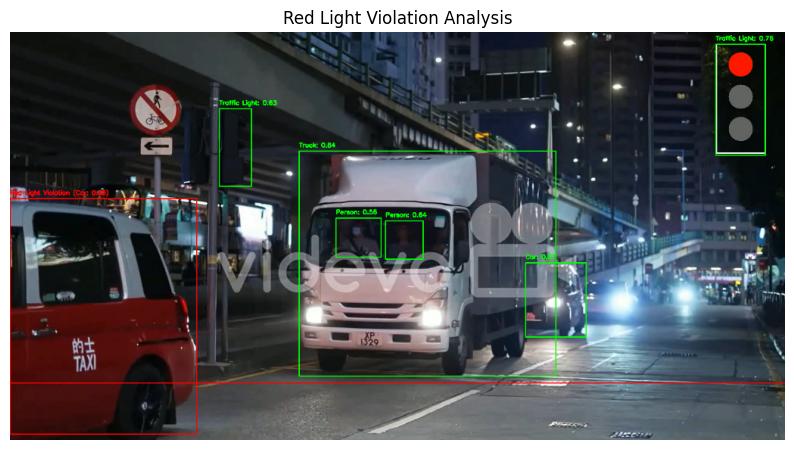

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:08:16] "POST /analyze HTTP/1.1" 200 -



0: 352x640 3 persons, 3 cars, 1 bus, 1 truck, 2 traffic lights, 2717.8ms
Speed: 3.9ms preprocess, 2717.8ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.90 at [1, 413, 325, 997]
Detected Object: Traffic Light: 0.76 at [1748, 30, 1871, 304]
Detected Object: Car: 0.72 at [1278, 567, 1408, 762]
Detected Object: Traffic Light: 0.71 at [518, 193, 600, 383]
Detected Object: Truck: 0.68 at [717, 300, 1344, 853]
Detected Object: Person: 0.66 at [807, 458, 918, 554]
Detected Object: Car: 0.61 at [1401, 611, 1540, 710]
Detected Object: Bus: 0.54 at [718, 297, 1344, 854]
Detected Object: Person: 0.51 at [931, 470, 1021, 563]
Bounding Box [1, 413, 325, 997]: Red Light Violation (Car: 0.90)
Bounding Box [1748, 30, 1871, 304]: Traffic Light: 0.76
Bounding Box [1278, 567, 1408, 762]: Car: 0.72
Bounding Box [518, 193, 600, 383]: Traffic Light: 0.71
Bounding Box [717, 300, 1344, 853]: Truck: 0.68
Bounding Box [807, 458, 918, 554]: Person: 0.66
Bounding Box [1

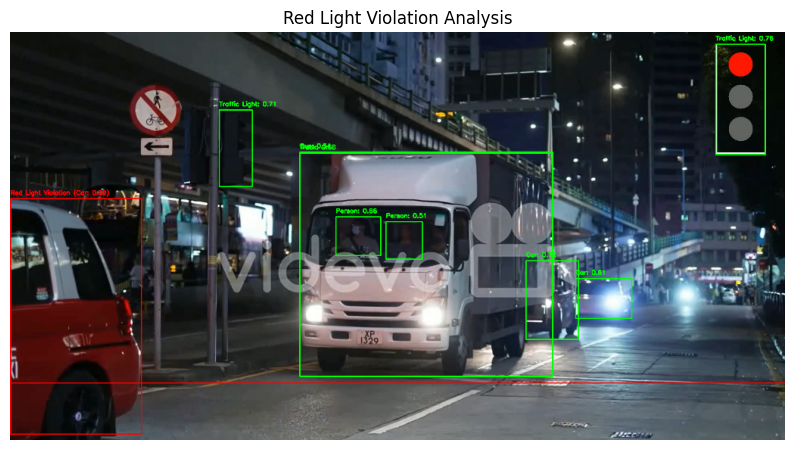

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:08:19] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 Traffic-Reds, 431.4ms
Speed: 18.1ms preprocess, 431.4ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED


0: 352x640 3 persons, 4 cars, 1 bus, 2 trucks, 2 traffic lights, 3164.9ms
Speed: 10.0ms preprocess, 3164.9ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.80 at [1349, 577, 1487, 737]
Detected Object: Traffic Light: 0.75 at [1748, 30, 1871, 305]
Detected Object: Bus: 0.69 at [884, 347, 1402, 814]
Detected Object: Truck: 0.68 at [888, 347, 1403, 815]
Detected Object: Truck: 0.65 at [0, 433, 733, 999]
Detected Object: Traffic Light: 0.56 at [519, 191, 603, 380]
Detected Object: Car: 0.55 at [0, 426, 732, 998]
Bounding Box [1349, 577, 1487, 737]: Car: 0.80
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.75
Bounding Box [884, 347, 1402, 814]: Bus: 0.69
Bounding Box [888, 347, 1403, 815]: Truck: 0.68
Bounding Box [0, 433, 733, 999]: Red Light Violat

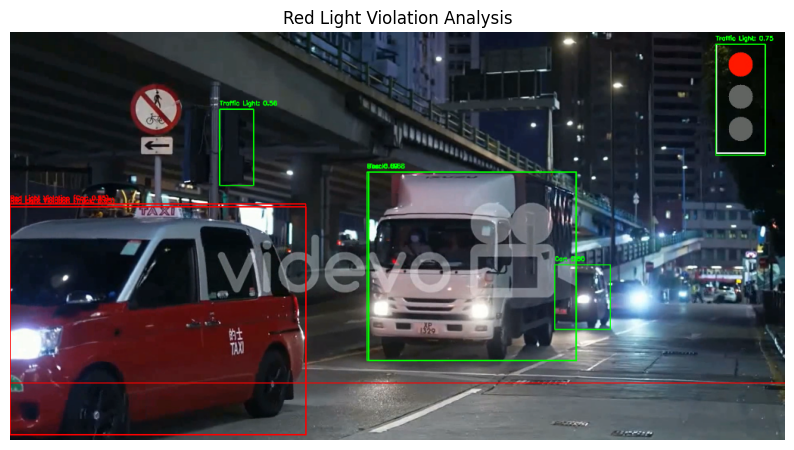

0: 352x640 1 Traffic-Red, 626.8ms
Speed: 12.6ms preprocess, 626.8ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED



INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:08:22] "POST /analyze HTTP/1.1" 200 -


0: 352x640 3 persons, 2 cars, 1 bus, 1 truck, 2 traffic lights, 3054.4ms
Speed: 21.5ms preprocess, 3054.4ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.80 at [719, 303, 1344, 860]
Detected Object: Traffic Light: 0.79 at [1748, 30, 1871, 304]
Detected Object: Car: 0.79 at [1378, 615, 1514, 731]
Detected Object: Traffic Light: 0.66 at [520, 201, 600, 389]
Detected Object: Bus: 0.61 at [144, 382, 496, 699]
Detected Object: Person: 0.54 at [820, 476, 912, 567]
Bounding Box [719, 303, 1344, 860]: Truck: 0.80
Bounding Box [1748, 30, 1871, 304]: Traffic Light: 0.79
Bounding Box [1378, 615, 1514, 731]: Car: 0.79
Bounding Box [520, 201, 600, 389]: Traffic Light: 0.66
Bounding Box [144, 382, 496, 699]: Bus: 0.61
Bounding Box [820, 476, 912, 567]: Person: 0.54


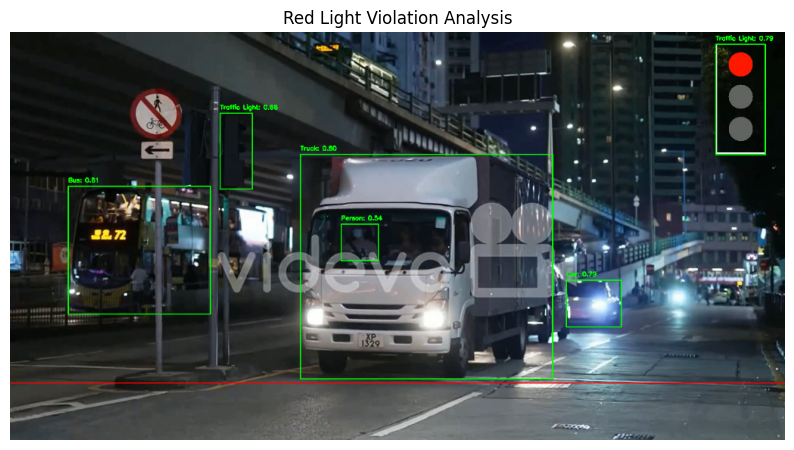

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:08:25] "POST /analyze HTTP/1.1" 200 -


0: 352x640 1 person, 3 cars, 2 trucks, 2 traffic lights, 2173.4ms
Speed: 21.3ms preprocess, 2173.4ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.90 at [797, 321, 1366, 832]
Detected Object: Car: 0.81 at [0, 415, 636, 999]
Detected Object: Traffic Light: 0.74 at [1748, 30, 1871, 305]
Bounding Box [797, 321, 1366, 832]: Truck: 0.90
Bounding Box [0, 415, 636, 999]: Red Light Violation (Car: 0.81)
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.74


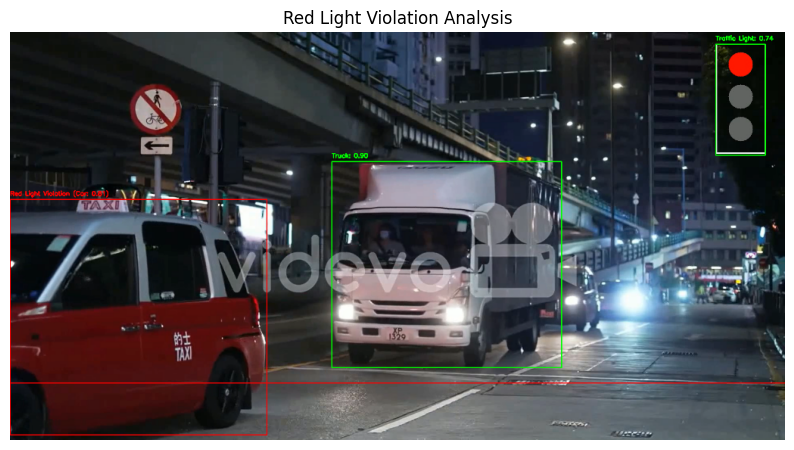

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:08:27] "POST /analyze HTTP/1.1" 200 -


0: 352x640 1 person, 5 cars, 2 buss, 1 truck, 1 traffic light, 2227.8ms
Speed: 4.8ms preprocess, 2227.8ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.84 at [970, 359, 1429, 789]
Detected Object: Car: 0.83 at [0, 443, 836, 995]
Detected Object: Car: 0.76 at [1382, 574, 1510, 722]
Detected Object: Bus: 0.76 at [155, 366, 492, 540]
Detected Object: Bus: 0.69 at [971, 359, 1429, 789]
Detected Object: Traffic Light: 0.57 at [523, 184, 599, 371]
Detected Object: Car: 0.55 at [1753, 618, 1804, 663]
Bounding Box [970, 359, 1429, 789]: Truck: 0.84
Bounding Box [0, 443, 836, 995]: Red Light Violation (Car: 0.83)
Bounding Box [1382, 574, 1510, 722]: Car: 0.76
Bounding Box [155, 366, 492, 540]: Bus: 0.76
Bounding Box [971, 359, 1429, 789]: Bus: 0.69
Bounding Box [523, 184, 599, 371]: Traffic Light: 0.57
Bounding Box [1753, 618, 1804, 663]: Car: 0.55


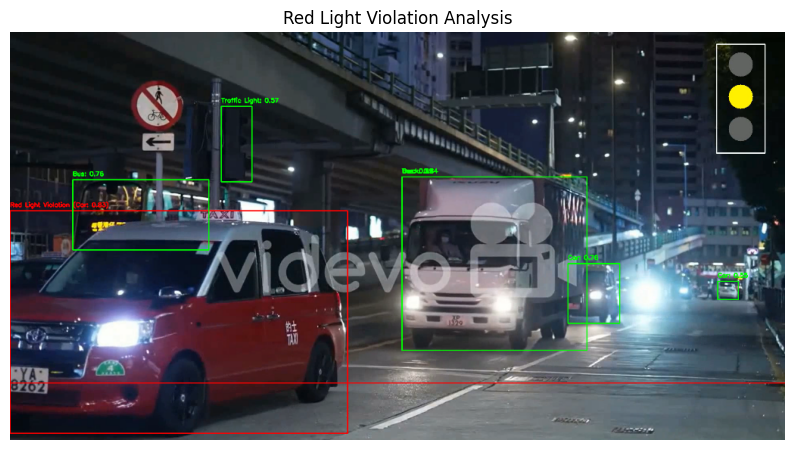

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:08:29] "POST /analyze HTTP/1.1" 200 -


0: 352x640 1 person, 3 cars, 1 bus, 1 truck, 2 traffic lights, 2404.4ms
Speed: 3.5ms preprocess, 2404.4ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.91 at [1, 427, 577, 995]
Detected Object: Car: 0.78 at [1296, 570, 1449, 748]
Detected Object: Traffic Light: 0.78 at [1748, 30, 1870, 304]
Detected Object: Person: 0.74 at [842, 471, 948, 559]
Detected Object: Truck: 0.70 at [756, 308, 1355, 843]
Bounding Box [1, 427, 577, 995]: Red Light Violation (Car: 0.91)
Bounding Box [1296, 570, 1449, 748]: Car: 0.78
Bounding Box [1748, 30, 1870, 304]: Traffic Light: 0.78
Bounding Box [842, 471, 948, 559]: Person: 0.74
Bounding Box [756, 308, 1355, 843]: Truck: 0.70


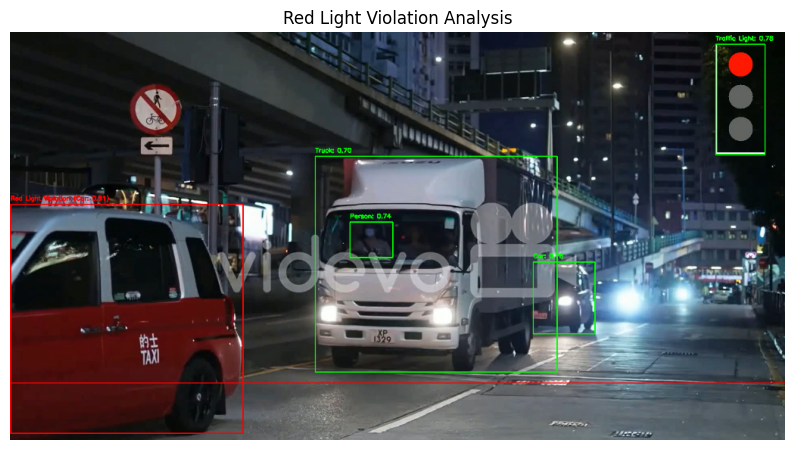

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:08:31] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 persons, 3 cars, 1 truck, 2 traffic lights, 2486.4ms
Speed: 6.6ms preprocess, 2486.4ms inference, 2.0ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.93 at [1, 413, 395, 996]
Detected Object: Truck: 0.76 at [717, 300, 1342, 854]
Detected Object: Person: 0.75 at [800, 460, 920, 561]
Detected Object: Car: 0.73 at [1408, 612, 1541, 710]
Detected Object: Car: 0.73 at [1277, 562, 1416, 758]
Detected Object: Traffic Light: 0.73 at [1748, 30, 1870, 304]
Detected Object: Traffic Light: 0.70 at [519, 191, 600, 381]
Detected Object: Person: 0.54 at [929, 469, 1018, 564]
Bounding Box [1, 413, 395, 996]: Red Light Violation (Car: 0.93)
Bounding Box [717, 300, 1342, 854]: Truck: 0.76
Bounding Box [800, 460, 920, 561]: Person: 0.75
Bounding Box [1408, 612, 1541, 710]: Car: 0.73
Bounding Box [1277, 562, 1416, 758]: Car: 0.73
Bounding Box [1748, 30, 1870, 304]: Traffic Light: 0.73
Bounding Box [519, 191, 600, 381]: Traffic Light: 0.70
Bounding Box [929, 469, 1018

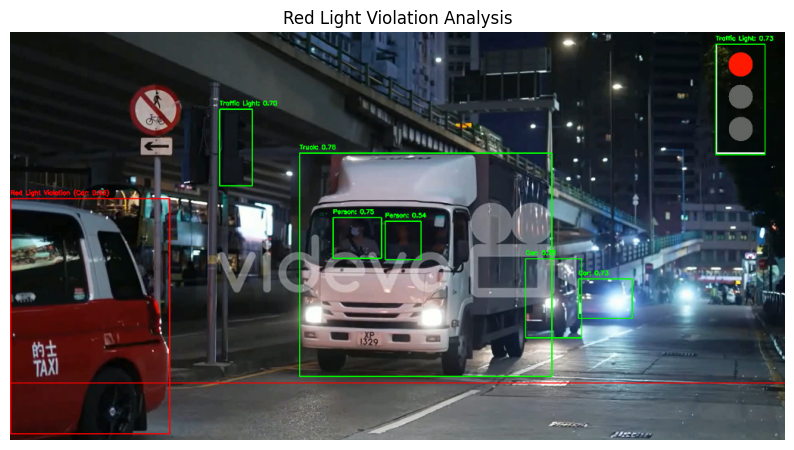

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:08:33] "POST /analyze HTTP/1.1" 200 -



0: 352x640 1 Traffic-Red, 205.6ms
Speed: 4.2ms preprocess, 205.6ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED


0: 352x640 2 Traffic-Reds, 396.7ms
Speed: 4.2ms preprocess, 396.7ms inference, 1.1ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 3 cars, 2 trucks, 2 traffic lights, 1953.5ms
Speed: 5.3ms preprocess, 1953.5ms inference, 2.1ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.86 at [0, 412, 454, 997]
Detected Object: Car: 0.85 at [1277, 569, 1426, 756]
Detected Object: Truck: 0.84 at [715, 294, 1348, 854]
Detected Object: Traffic Light: 0.74 at [1748, 30, 1871, 304]
Detected Object: Person: 0.67 at [930, 467, 1022, 564]
Detected Object: Traffic Light: 0.59 at [518, 190, 598, 382]
Detected Object: Person: 0.54 at [812, 461, 920, 560]
Bounding Box [0, 412, 454, 997]: Red Light Violation 

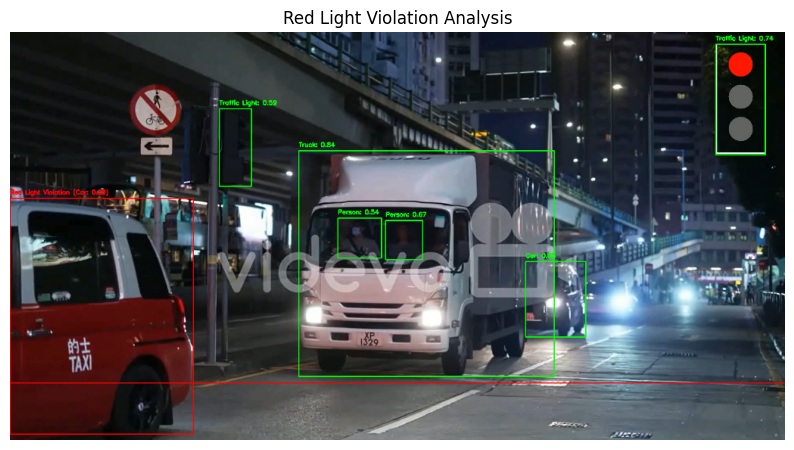

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:08:55] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 persons, 2 cars, 1 bus, 1 truck, 2 traffic lights, 2356.2ms
Speed: 3.6ms preprocess, 2356.2ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.88 at [0, 445, 684, 998]
Detected Object: Truck: 0.87 at [844, 335, 1383, 823]
Detected Object: Traffic Light: 0.75 at [1748, 30, 1871, 305]
Detected Object: Bus: 0.67 at [843, 334, 1385, 823]
Detected Object: Car: 0.64 at [1335, 576, 1475, 740]
Detected Object: Traffic Light: 0.62 at [518, 189, 600, 381]
Detected Object: Person: 0.57 at [925, 478, 1013, 565]
Bounding Box [0, 445, 684, 998]: Red Light Violation (Car: 0.88)
Bounding Box [844, 335, 1383, 823]: Truck: 0.87
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.75
Bounding Box [843, 334, 1385, 823]: Bus: 0.67
Bounding Box [1335, 576, 1475, 740]: Car: 0.64
Bounding Box [518, 189, 600, 381]: Traffic Light: 0.62
Bounding Box [925, 478, 1013, 565]: Person: 0.57


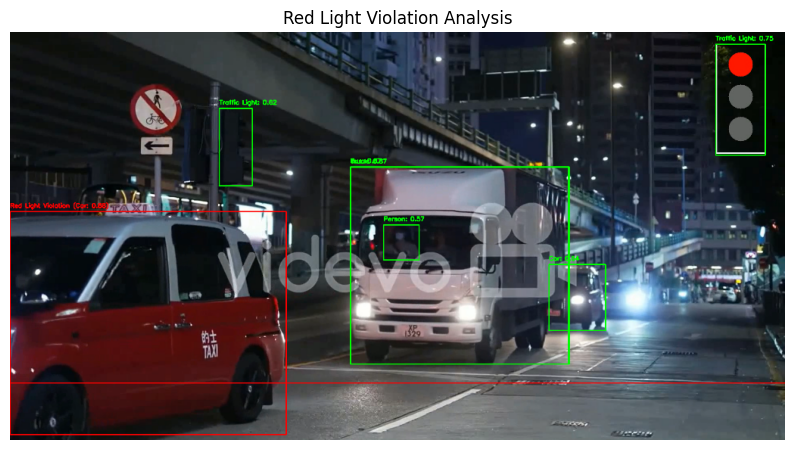

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:08:57] "POST /analyze HTTP/1.1" 200 -



0: 352x640 2 Traffic-Reds, 238.7ms
Speed: 4.0ms preprocess, 238.7ms inference, 2.0ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED



0: 352x640 2 Traffic-Reds, 425.2ms
Speed: 17.5ms preprocess, 425.2ms inference, 1.1ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 1 Traffic-Red, 413.1ms
Speed: 4.5ms preprocess, 413.1ms inference, 8.3ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 3 cars, 1 truck, 2 traffic lights, 2382.4ms
Speed: 4.0ms preprocess, 2382.4ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.90 at [793, 321, 1364, 834]
Detected Object: Car: 0.82 at [0, 431, 630, 998]
Detected Object: Traffic Light: 0.75 at [1748, 30, 1871, 304]
Detected Object: Car: 0.66 at [1345, 576, 1461, 743

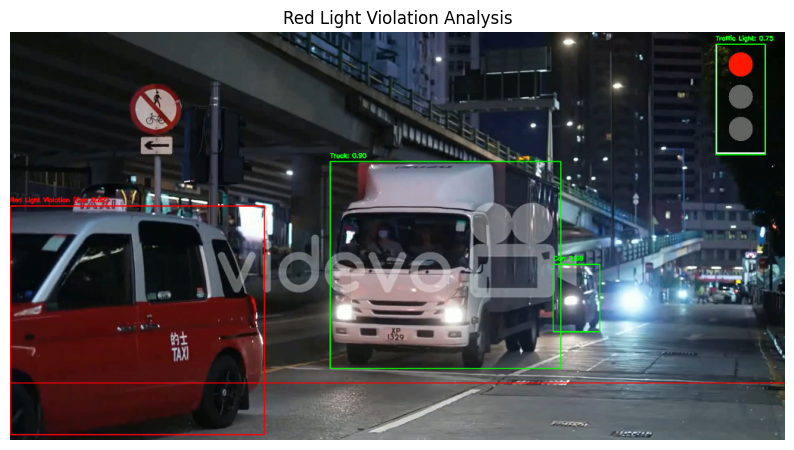

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:04] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 persons, 4 cars, 2 buss, 1 truck, 2 traffic lights, 2536.7ms
Speed: 10.0ms preprocess, 2536.7ms inference, 1.9ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.90 at [0, 474, 157, 999]
Detected Object: Car: 0.79 at [1385, 613, 1521, 725]
Detected Object: Traffic Light: 0.77 at [1748, 30, 1871, 305]
Detected Object: Traffic Light: 0.75 at [517, 192, 599, 384]
Detected Object: Truck: 0.73 at [718, 301, 1343, 856]
Detected Object: Person: 0.69 at [817, 460, 923, 560]
Detected Object: Bus: 0.68 at [143, 380, 493, 697]
Detected Object: Bus: 0.50 at [718, 299, 1344, 857]
Bounding Box [0, 474, 157, 999]: Red Light Violation (Car: 0.90)
Bounding Box [1385, 613, 1521, 725]: Car: 0.79
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.77
Bounding Box [517, 192, 599, 384]: Traffic Light: 0.75
Bounding Box [718, 301, 1343, 856]: Truck: 0.73
Bounding Box [817, 460, 923, 560]: Person: 0.69
Bounding Box [143, 380, 493, 697]: Bus: 0.68
Bounding Box [718, 299, 13

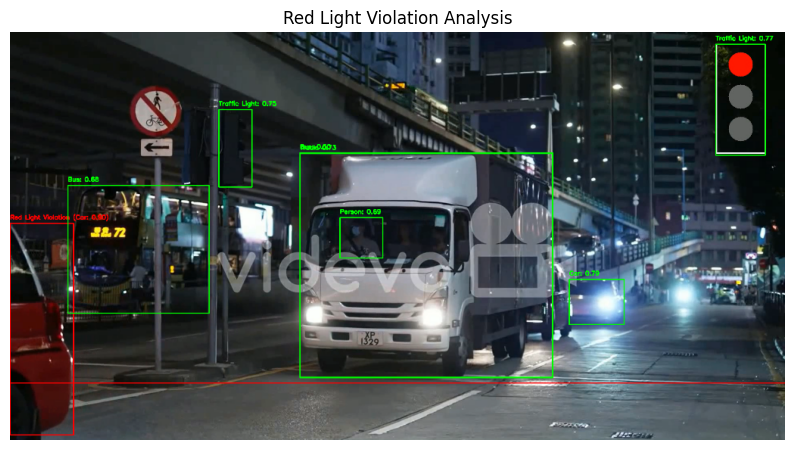

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:07] "POST /analyze HTTP/1.1" 200 -


0: 352x640 5 persons, 1 car, 2 buss, 1 truck, 2 traffic lights, 2432.5ms
Speed: 5.0ms preprocess, 2432.5ms inference, 1.8ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.84 at [1376, 618, 1511, 737]
Detected Object: Traffic Light: 0.82 at [1748, 30, 1872, 304]
Detected Object: Truck: 0.79 at [719, 304, 1349, 861]
Detected Object: Traffic Light: 0.65 at [520, 203, 598, 392]
Detected Object: Bus: 0.62 at [142, 383, 698, 709]
Detected Object: Person: 0.59 at [820, 473, 913, 568]
Bounding Box [1376, 618, 1511, 737]: Car: 0.84
Bounding Box [1748, 30, 1872, 304]: Traffic Light: 0.82
Bounding Box [719, 304, 1349, 861]: Truck: 0.79
Bounding Box [520, 203, 598, 392]: Traffic Light: 0.65
Bounding Box [142, 383, 698, 709]: Bus: 0.62
Bounding Box [820, 473, 913, 568]: Person: 0.59

0: 352x640 2 Traffic-Reds, 412.5ms
Speed: 4.0ms preprocess, 412.5ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RE

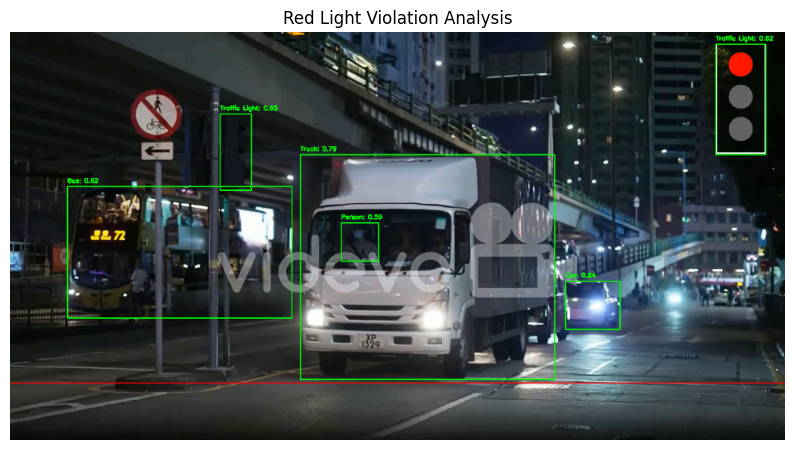

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:09] "POST /analyze HTTP/1.1" 200 -



0: 352x640 2 Traffic-Reds, 557.9ms
Speed: 11.7ms preprocess, 557.9ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 1 Traffic-Red, 422.3ms
Speed: 4.1ms preprocess, 422.3ms inference, 8.4ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 3 cars, 1 bus, 1 truck, 2 traffic lights, 2588.5ms
Speed: 13.7ms preprocess, 2588.5ms inference, 1.8ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.92 at [1, 414, 317, 997]
Detected Object: Traffic Light: 0.75 at [1748, 30, 1870, 304]
Detected Object: Truck: 0.72 at [717, 300, 1342, 853]
Detected Object: Car: 0.70 at [1279, 564, 1407, 762]
Detected Object: Traffic Light: 0.69 at [518, 193, 599, 382]
Detected Object: Car: 0.66 at [1400, 611, 1537, 714]
Detected Object: Person: 0.62 at [806, 457, 916, 558]
Bounding Box [1, 414, 317, 997]: Red Light Viola

ERROR:__main__:Exception on /analyze [POST]
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/werkzeug/serving.py", line 110, in read_chunk_len
    _len = int(line.strip(), 16)
ValueError: invalid literal for int() with base 16: ''

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/flask/app.py", line 1473, in wsgi_app
    response = self.full_dispatch_request()
  File "/usr/local/lib/python3.10/dist-packages/flask/app.py", line 882, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "/usr/local/lib/python3.10/dist-packages/flask/app.py", line 880, in full_dispatch_request
    rv = self.dispatch_request()
  File "/usr/local/lib/python3.10/dist-packages/flask/app.py", line 865, in dispatch_request
    return self.ensure_sync(self.view_functions[rule.endpoint])(**view_args)  # type: ignore[no-any-return]
  File "<ipython-input-13-585b


0: 352x640 1 Traffic-Red, 676.9ms
Speed: 28.8ms preprocess, 676.9ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 1 Traffic-Red, 668.6ms
Speed: 4.0ms preprocess, 668.6ms inference, 10.6ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED



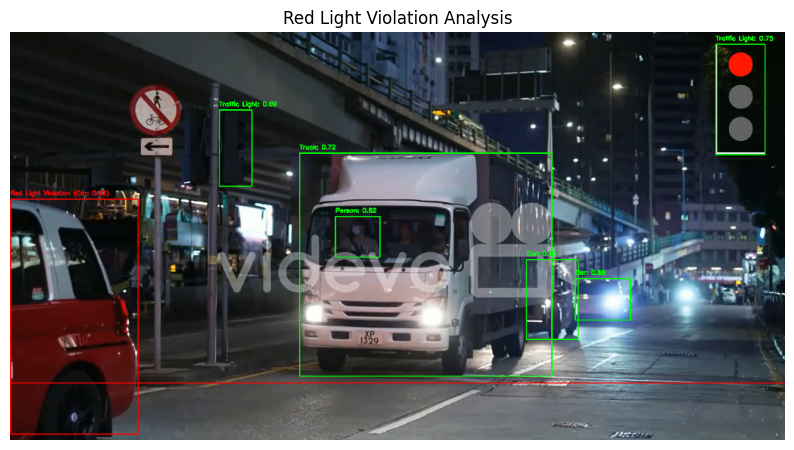

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:13] "POST /analyze HTTP/1.1" 200 -



0: 352x640 1 Traffic-Red, 375.8ms
Speed: 4.0ms preprocess, 375.8ms inference, 1.1ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 1 person, 4 cars, 1 bus, 2 trucks, 2 traffic lights, 3489.2ms
Speed: 4.0ms preprocess, 3489.2ms inference, 1.4ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.83 at [882, 345, 1402, 816]
Detected Object: Car: 0.81 at [1349, 577, 1486, 737]
Detected Object: Traffic Light: 0.75 at [1748, 30, 1871, 305]
Detected Object: Bus: 0.71 at [881, 345, 1402, 815]
Detected Object: Truck: 0.67 at [0, 437, 728, 1000]
Detected Object: Traffic Light: 0.58 at [519, 193, 603, 380]
Detected Object: Car: 0.52 at [0, 428, 727, 998]
Bounding Box [882, 345, 1402, 816]: Truck: 0.83
Bounding Box [1349, 577, 1486, 737]: Car: 0.81
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.75
Bounding Box [881, 345, 1402, 815]: Bus: 0.71
Bounding Box [0, 437, 728, 1000]: Red Light Violatio

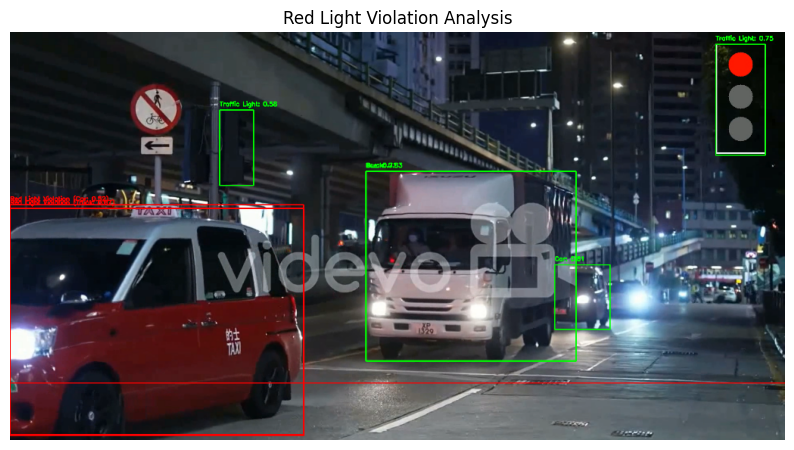

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:16] "POST /analyze HTTP/1.1" 200 -



0: 352x640 1 Traffic-Red, 469.5ms
Speed: 5.9ms preprocess, 469.5ms inference, 8.5ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED


0: 352x640 3 persons, 2 cars, 3 buss, 1 truck, 2 traffic lights, 3153.7ms
Speed: 3.7ms preprocess, 3153.7ms inference, 2.0ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.83 at [719, 304, 1345, 860]
Detected Object: Car: 0.79 at [1377, 616, 1514, 730]
Detected Object: Traffic Light: 0.79 at [1748, 30, 1871, 305]
Detected Object: Traffic Light: 0.73 at [521, 203, 599, 389]
Detected Object: Person: 0.55 at [821, 477, 912, 568]
Bounding Box [719, 304, 1345, 860]: Truck: 0.83
Bounding Box [1377, 616, 1514, 730]: Car: 0.79
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.79
Bounding Box [521, 203, 599, 389]: Traffic Light: 0.73
Bounding Box [821, 477, 912, 568]: Person: 0.55

0: 352x640 1 Traffic-Red, 1 Traffic-Yellow, 615.3ms
Speed: 6.4ms preprocess, 615.3ms infere

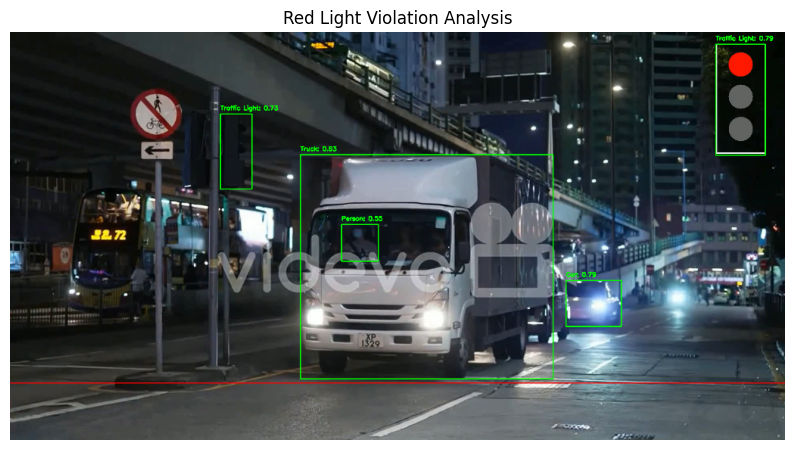

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:19] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 persons, 3 cars, 1 bus, 2 trucks, 2 traffic lights, 2807.8ms
Speed: 6.8ms preprocess, 2807.8ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.83 at [732, 304, 1353, 847]
Detected Object: Traffic Light: 0.76 at [1748, 31, 1871, 304]
Detected Object: Car: 0.73 at [0, 416, 526, 996]
Detected Object: Car: 0.69 at [1285, 573, 1439, 752]
Detected Object: Person: 0.68 at [824, 480, 932, 562]
Detected Object: Traffic Light: 0.57 at [518, 190, 599, 383]
Bounding Box [732, 304, 1353, 847]: Truck: 0.83
Bounding Box [1748, 31, 1871, 304]: Traffic Light: 0.76
Bounding Box [0, 416, 526, 996]: Red Light Violation (Car: 0.73)
Bounding Box [1285, 573, 1439, 752]: Car: 0.69
Bounding Box [824, 480, 932, 562]: Person: 0.68
Bounding Box [518, 190, 599, 383]: Traffic Light: 0.57



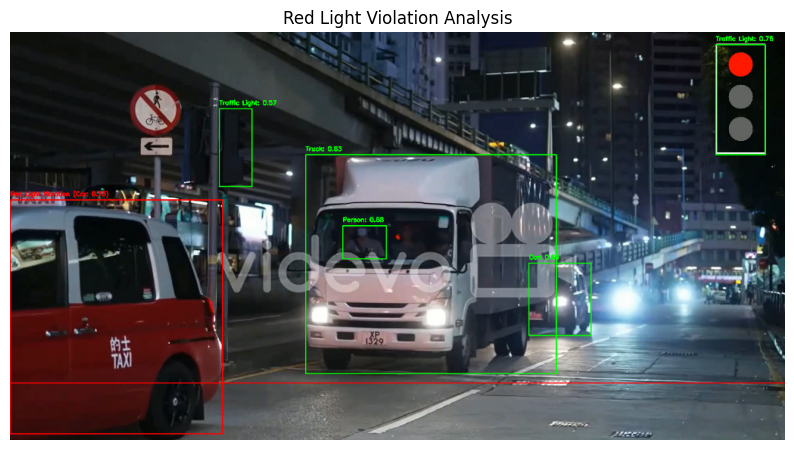

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:22] "POST /analyze HTTP/1.1" 200 -


0: 352x640 1 Traffic-Red, 515.6ms
Speed: 10.4ms preprocess, 515.6ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 4 cars, 1 bus, 1 truck, 2 traffic lights, 2513.7ms
Speed: 4.2ms preprocess, 2513.7ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.90 at [1, 421, 571, 996]
Detected Object: Traffic Light: 0.78 at [1748, 30, 1871, 304]
Detected Object: Car: 0.77 at [1291, 566, 1448, 749]
Detected Object: Truck: 0.71 at [752, 308, 1354, 844]
Detected Object: Person: 0.71 at [840, 473, 947, 562]
Detected Object: Traffic Light: 0.55 at [518, 188, 597, 381]
Bounding Box [1, 421, 571, 996]: Red Light Violation (Car: 0.90)
Bounding Box [1748, 30, 1871, 304]: Traffic Light: 0.78
Bounding Box [1291, 566, 1448, 749]: Car: 0.77
Bounding Box [752, 308, 1354, 844]: Truck: 0.71
Bounding Box [840, 473, 947, 562]: Person: 0.71
Bounding Box [518, 188, 597, 381]: 

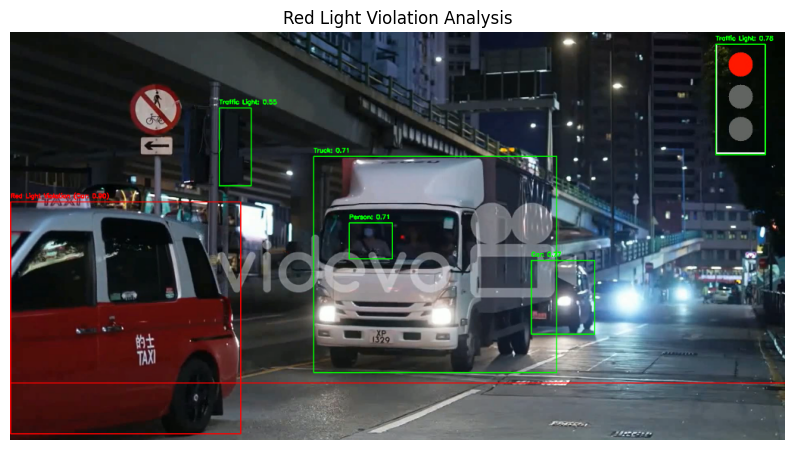

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:24] "POST /analyze HTTP/1.1" 200 -



0: 352x640 2 Traffic-Reds, 369.4ms
Speed: 6.0ms preprocess, 369.4ms inference, 7.9ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 3 cars, 1 bus, 1 truck, 2 traffic lights, 2464.3ms
Speed: 9.8ms preprocess, 2464.3ms inference, 2.0ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.86 at [718, 301, 1344, 857]
Detected Object: Car: 0.80 at [1381, 613, 1524, 728]
Detected Object: Traffic Light: 0.78 at [1747, 30, 1871, 304]
Detected Object: Traffic Light: 0.73 at [520, 193, 599, 386]
Detected Object: Car: 0.62 at [0, 687, 41, 992]
Detected Object: Bus: 0.62 at [143, 381, 494, 700]
Detected Object: Person: 0.61 at [816, 472, 919, 568]
Bounding Box [718, 301, 1344, 857]: Truck: 0.86
Bounding Box [1381, 613, 1524, 728]: Car: 0.80
Bounding Box [1747, 30, 1871, 304]: Traffic Light: 0.78
Bounding Box [520, 193, 599, 386]: Traffic Light: 0.73
Bounding Box [0, 687, 41, 992]: Red Light 

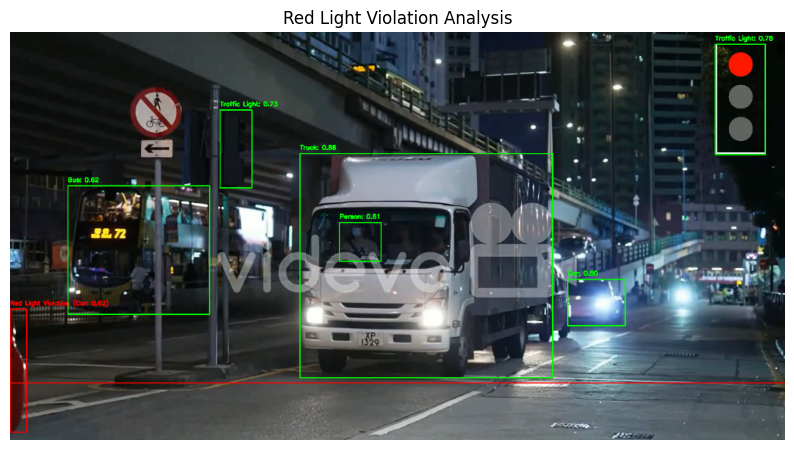

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:27] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 Traffic-Reds, 508.0ms
Speed: 7.8ms preprocess, 508.0ms inference, 7.9ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 3 cars, 1 truck, 2 traffic lights, 2668.3ms
Speed: 4.2ms preprocess, 2668.3ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.94 at [1, 413, 388, 997]
Detected Object: Truck: 0.77 at [716, 301, 1342, 854]
Detected Object: Person: 0.75 at [804, 459, 918, 558]
Detected Object: Car: 0.74 at [1277, 564, 1415, 758]
Detected Object: Traffic Light: 0.72 at [1748, 30, 1870, 304]
Detected Object: Car: 0.71 at [1407, 612, 1538, 704]
Detected Object: Traffic Light: 0.67 at [519, 192, 600, 381]
Detected Object: Person: 0.55 at [929, 470, 1016, 563]
Bounding Box [1, 413, 388, 997]: Red Light Violation (Car: 0.94)
Bounding Box [716, 301, 1342, 854]: Truck: 0.77
Bounding Box [804, 459, 918, 558]: Person: 0.75
Bounding 

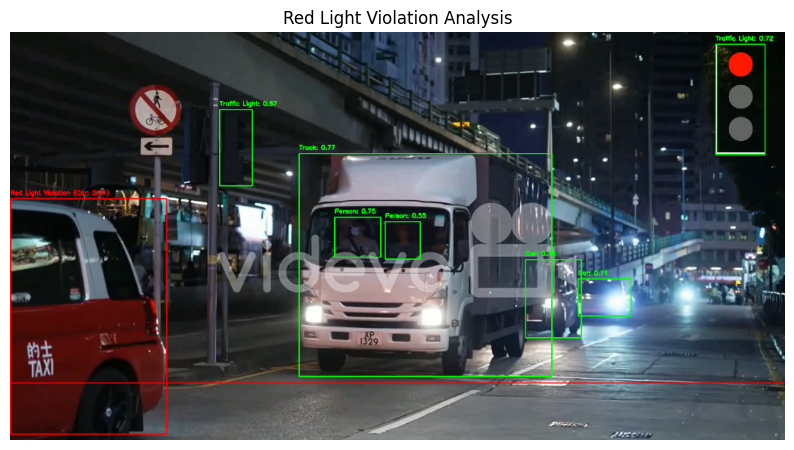

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:29] "POST /analyze HTTP/1.1" 200 -



0: 352x640 2 Traffic-Reds, 404.8ms
Speed: 7.9ms preprocess, 404.8ms inference, 8.5ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED


0: 352x640 2 Traffic-Reds, 393.4ms
Speed: 12.8ms preprocess, 393.4ms inference, 1.1ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 1 person, 5 cars, 2 buss, 1 truck, 1 traffic light, 2891.3ms
Speed: 14.7ms preprocess, 2891.3ms inference, 1.8ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.83 at [966, 357, 1427, 790]
Detected Object: Car: 0.83 at [0, 440, 829, 996]
Detected Object: Car: 0.79 at [1380, 574, 1508, 723]
Detected Object: Bus: 0.71 at [155, 366, 489, 527]
Detected Object: Bus: 0.65 at [967, 357, 1427, 790]
Detected Object: Car: 0.62 at [1751, 617, 1804, 663]
Detected Object: Traffic Light: 0.60 at [522, 185, 600, 371]
Detected Object: Car: 0.50 at [0, 557, 130, 654]
Bounding Bo

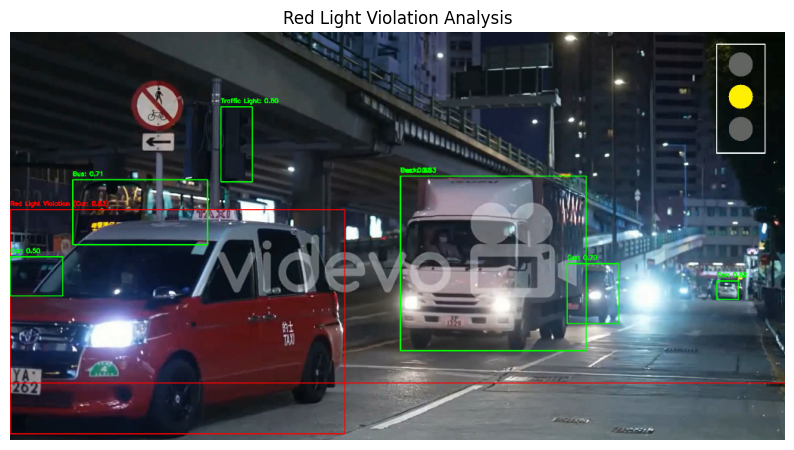

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:32] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 persons, 4 cars, 2 buss, 1 truck, 2 traffic lights, 2452.2ms
Speed: 7.8ms preprocess, 2452.2ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.86 at [1, 424, 248, 996]
Detected Object: Car: 0.79 at [1392, 612, 1535, 724]
Detected Object: Traffic Light: 0.78 at [1748, 30, 1871, 305]
Detected Object: Truck: 0.71 at [717, 300, 1343, 855]
Detected Object: Traffic Light: 0.71 at [518, 192, 600, 383]
Detected Object: Person: 0.71 at [794, 458, 917, 561]
Detected Object: Car: 0.64 at [1279, 567, 1400, 764]
Bounding Box [1, 424, 248, 996]: Red Light Violation (Car: 0.86)
Bounding Box [1392, 612, 1535, 724]: Car: 0.79
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.78
Bounding Box [717, 300, 1343, 855]: Truck: 0.71
Bounding Box [518, 192, 600, 383]: Traffic Light: 0.71
Bounding Box [794, 458, 917, 561]: Person: 0.71
Bounding Box [1279, 567, 1400, 764]: Car: 0.64



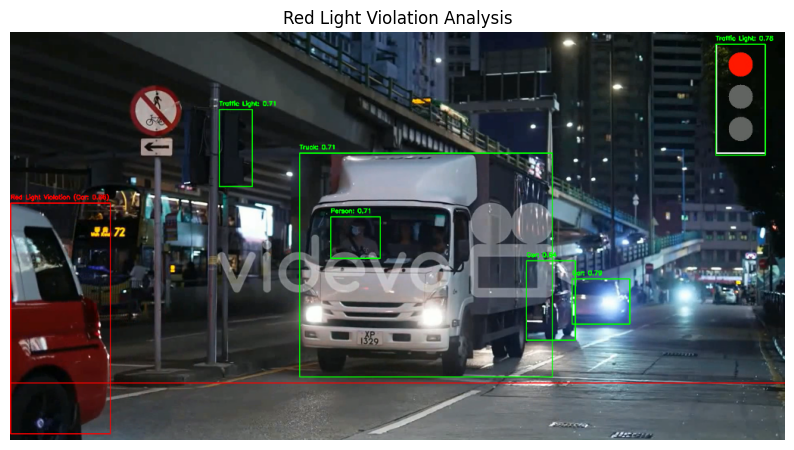

0: 352x640 1 Traffic-Red, 591.1ms
Speed: 10.9ms preprocess, 591.1ms inference, 5.4ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED



INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:35] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 persons, 3 cars, 2 trucks, 2 traffic lights, 2886.1ms
Speed: 5.1ms preprocess, 2886.1ms inference, 2.1ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.83 at [715, 294, 1349, 854]
Detected Object: Car: 0.83 at [1277, 569, 1425, 757]
Detected Object: Traffic Light: 0.75 at [1748, 30, 1871, 304]
Detected Object: Car: 0.67 at [0, 415, 446, 997]
Detected Object: Person: 0.66 at [929, 465, 1022, 564]
Detected Object: Person: 0.65 at [807, 460, 918, 561]
Detected Object: Traffic Light: 0.58 at [518, 190, 598, 382]
Detected Object: Truck: 0.51 at [1, 416, 446, 995]
Bounding Box [715, 294, 1349, 854]: Truck: 0.83
Bounding Box [1277, 569, 1425, 757]: Car: 0.83
Bounding Box [1748, 30, 1871, 304]: Traffic Light: 0.75
Bounding Box [0, 415, 446, 997]: Red Light Violation (Car: 0.67)
Bounding Box [929, 465, 1022, 564]: Person: 0.66
Bounding Box [807, 460, 918, 561]: Person: 0.65
Bounding Box [518, 190, 598, 382]: Traffic Light: 0.58
Bounding Box [1, 416, 446, 

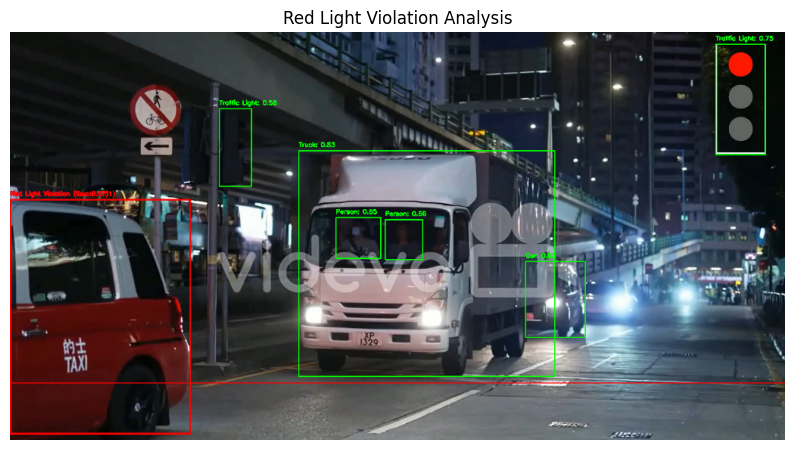

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:38] "POST /analyze HTTP/1.1" 200 -



0: 352x640 2 Traffic-Reds, 398.4ms
Speed: 4.1ms preprocess, 398.4ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 2 cars, 1 bus, 1 truck, 2 traffic lights, 2742.7ms
Speed: 7.6ms preprocess, 2742.7ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.86 at [0, 446, 679, 998]
Detected Object: Truck: 0.85 at [838, 334, 1382, 825]
Detected Object: Traffic Light: 0.76 at [1748, 30, 1871, 305]
Detected Object: Person: 0.70 at [914, 477, 1011, 568]
Detected Object: Bus: 0.65 at [836, 333, 1383, 825]
Detected Object: Car: 0.60 at [1329, 577, 1475, 741]
Detected Object: Traffic Light: 0.55 at [519, 188, 598, 382]
Bounding Box [0, 446, 679, 998]: Red Light Violation (Car: 0.86)
Bounding Box [838, 334, 1382, 825]: Truck: 0.85
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.76
Bounding Box [914, 477, 1011, 568]: Person: 0.70
Bounding Box [836, 333, 138

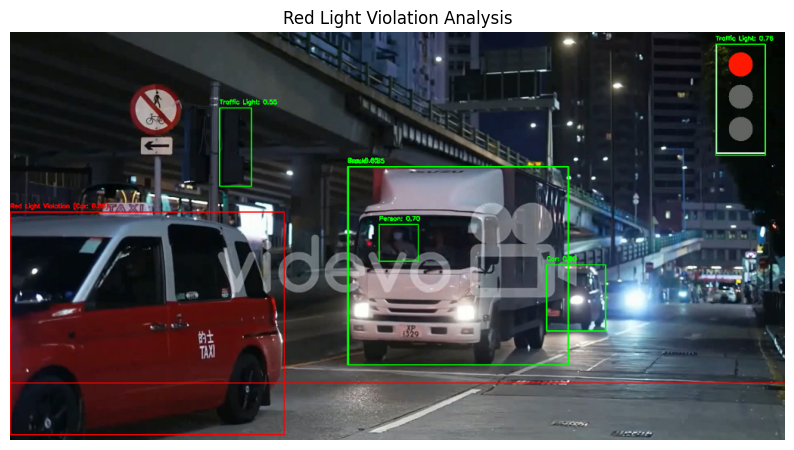

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:41] "POST /analyze HTTP/1.1" 200 -



0: 352x640 2 Traffic-Reds, 415.9ms
Speed: 4.2ms preprocess, 415.9ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 1 person, 4 cars, 1 bus, 1 truck, 2 traffic lights, 2694.8ms
Speed: 7.5ms preprocess, 2694.8ms inference, 1.4ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.85 at [0, 444, 780, 996]
Detected Object: Car: 0.84 at [1365, 575, 1500, 729]
Detected Object: Traffic Light: 0.80 at [1748, 30, 1871, 304]
Detected Object: Bus: 0.79 at [927, 353, 1410, 799]
Detected Object: Truck: 0.79 at [927, 352, 1413, 800]
Detected Object: Car: 0.73 at [1742, 622, 1812, 667]
Detected Object: Traffic Light: 0.64 at [523, 184, 600, 373]
Bounding Box [0, 444, 780, 996]: Red Light Violation (Car: 0.85)
Bounding Box [1365, 575, 1500, 729]: Car: 0.84
Bounding Box [1748, 30, 1871, 304]: Traffic Light: 0.80
Bounding Box [927, 353, 1410, 799]: Bus: 0.79
Bounding Box [927, 352, 1413, 800]

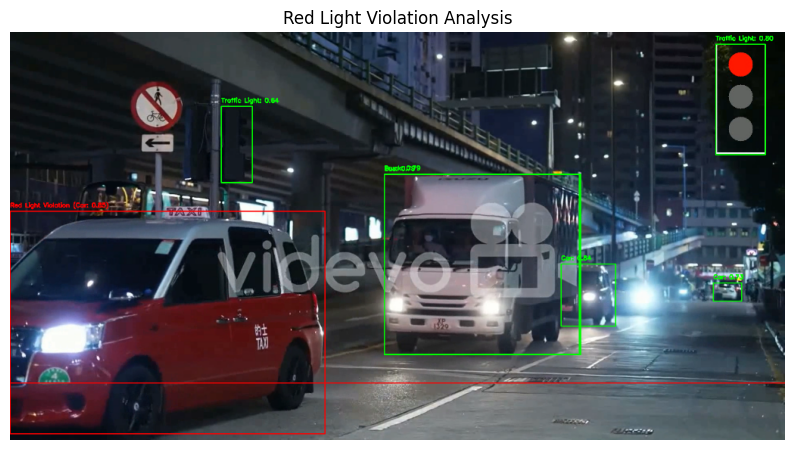

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:44] "POST /analyze HTTP/1.1" 200 -


0: 352x640 1 Traffic-Red, 639.7ms
Speed: 18.7ms preprocess, 639.7ms inference, 9.2ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 1 person, 3 cars, 1 truck, 2 traffic lights, 2702.7ms
Speed: 5.6ms preprocess, 2702.7ms inference, 10.7ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.90 at [786, 320, 1362, 835]

Detected Object: Car: 0.85 at [1, 432, 623, 999]
Detected Object: Traffic Light: 0.74 at [1748, 30, 1871, 305]
Detected Object: Car: 0.67 at [1347, 575, 1460, 742]
Detected Object: Person: 0.58 at [867, 472, 971, 562]
Bounding Box [786, 320, 1362, 835]: Truck: 0.90
Bounding Box [1, 432, 623, 999]: Red Light Violation (Car: 0.85)
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.74
Bounding Box [1347, 575, 1460, 742]: Car: 0.67
Bounding Box [867, 472, 971, 562]: Person: 0.58
0: 352x640 1 Traffic-Red, 605.8ms
Speed: 9.7ms preprocess, 605.8ms inference, 1.3ms postprocess per im

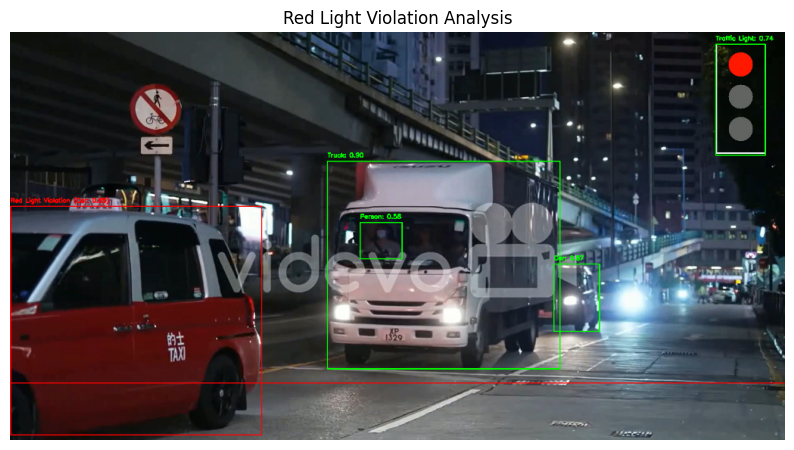

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:46] "POST /analyze HTTP/1.1" 200 -


0: 352x640 3 persons, 3 cars, 2 buss, 1 truck, 2 traffic lights, 2548.9ms
Speed: 3.8ms preprocess, 2548.9ms inference, 1.8ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.89 at [0, 492, 145, 998]
Detected Object: Car: 0.81 at [1385, 614, 1522, 725]
Detected Object: Traffic Light: 0.78 at [518, 194, 599, 384]
Detected Object: Truck: 0.78 at [719, 301, 1344, 857]
Detected Object: Traffic Light: 0.77 at [1748, 30, 1871, 305]
Detected Object: Person: 0.68 at [815, 461, 923, 561]
Detected Object: Bus: 0.62 at [141, 380, 494, 696]
Bounding Box [0, 492, 145, 998]: Red Light Violation (Car: 0.89)
Bounding Box [1385, 614, 1522, 725]: Car: 0.81
Bounding Box [518, 194, 599, 384]: Traffic Light: 0.78
Bounding Box [719, 301, 1344, 857]: Truck: 0.78
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.77
Bounding Box [815, 461, 923, 561]: Person: 0.68
Bounding Box [141, 380, 494, 696]: Bus: 0.62

0: 352x640 1 Traffic-Red, 622.3ms
Speed: 17.9ms preprocess, 622.3ms inference,

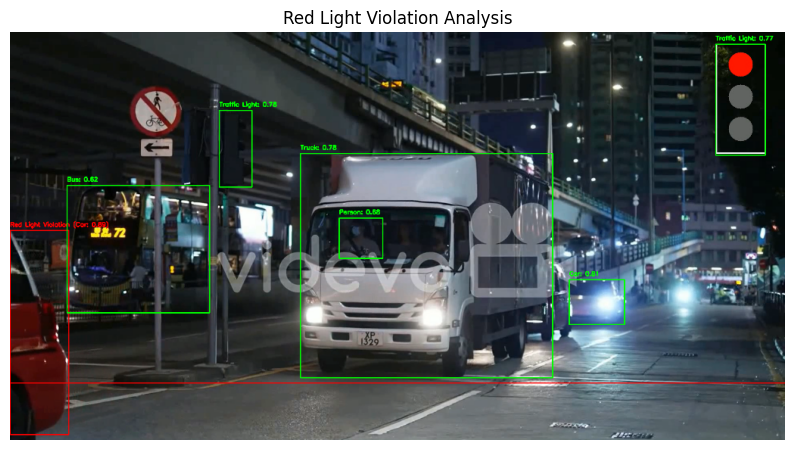

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:49] "POST /analyze HTTP/1.1" 200 -


0: 352x640 5 persons, 1 car, 2 buss, 1 truck, 2 traffic lights, 2749.6ms
Speed: 4.0ms preprocess, 2749.6ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.84 at [1376, 618, 1511, 737]
Detected Object: Traffic Light: 0.82 at [1748, 30, 1872, 304]
Detected Object: Truck: 0.80 at [719, 304, 1349, 861]
Detected Object: Bus: 0.66 at [142, 383, 699, 708]
Detected Object: Traffic Light: 0.63 at [520, 202, 598, 392]
Detected Object: Person: 0.61 at [820, 472, 913, 568]
Bounding Box [1376, 618, 1511, 737]: Car: 0.84
Bounding Box [1748, 30, 1872, 304]: Traffic Light: 0.82
Bounding Box [719, 304, 1349, 861]: Truck: 0.80
Bounding Box [142, 383, 699, 708]: Bus: 0.66
Bounding Box [520, 202, 598, 392]: Traffic Light: 0.63
Bounding Box [820, 472, 913, 568]: Person: 0.61


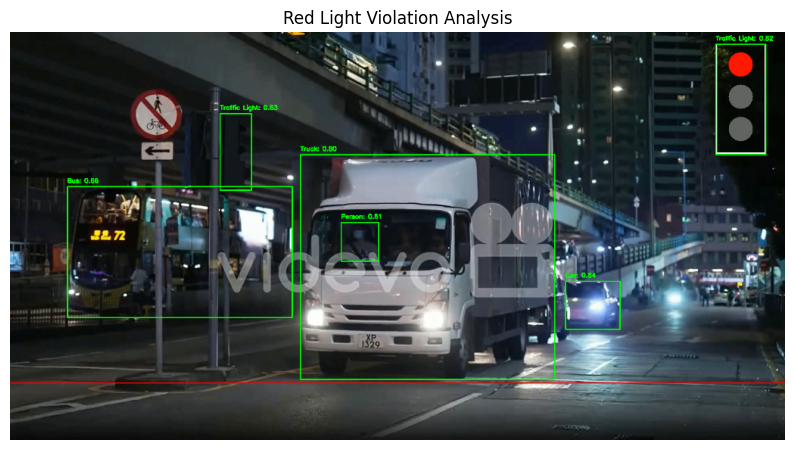

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:51] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 persons, 4 cars, 1 bus, 1 truck, 2 traffic lights, 2468.5ms
Speed: 3.7ms preprocess, 2468.5ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.92 at [1, 414, 307, 996]
Detected Object: Traffic Light: 0.74 at [1748, 30, 1870, 304]
Detected Object: Traffic Light: 0.74 at [518, 192, 599, 382]
Detected Object: Car: 0.68 at [1398, 612, 1535, 714]
Detected Object: Car: 0.67 at [1279, 563, 1406, 762]
Detected Object: Person: 0.67 at [806, 458, 915, 558]
Detected Object: Bus: 0.66 at [718, 298, 1343, 855]
Bounding Box [1, 414, 307, 996]: Red Light Violation (Car: 0.92)
Bounding Box [1748, 30, 1870, 304]: Traffic Light: 0.74
Bounding Box [518, 192, 599, 382]: Traffic Light: 0.74
Bounding Box [1398, 612, 1535, 714]: Car: 0.68
Bounding Box [1279, 563, 1406, 762]: Car: 0.67
Bounding Box [806, 458, 915, 558]: Person: 0.67
Bounding Box [718, 298, 1343, 855]: Bus: 0.66


0: 352x640 1 Traffic-Red, 743.2ms
Speed: 21.2ms preprocess, 743.2ms inference,

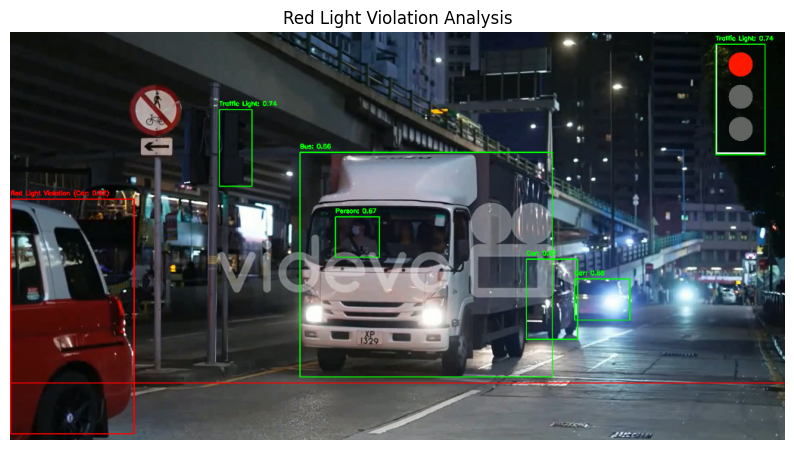

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:54] "POST /analyze HTTP/1.1" 200 -


0: 352x640 1 Traffic-Red, 697.2ms
Speed: 4.0ms preprocess, 697.2ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED


0: 352x640 2 Traffic-Reds, 408.6ms
Speed: 3.9ms preprocess, 408.6ms inference, 7.0ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 3 cars, 1 bus, 2 trucks, 2 traffic lights, 3566.6ms
Speed: 17.0ms preprocess, 3566.6ms inference, 2.4ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.80 at [1347, 578, 1484, 738]
Detected Object: Traffic Light: 0.75 at [1748, 30, 1871, 305]
Detected Object: Truck: 0.71 at [878, 345, 1403, 816]
Detected Object: Car: 0.64 at [0, 420, 720, 998]
Detected Object: Truck: 0.60 at [0, 427, 720, 1000]
Detected Object: Bus: 0.59 at [876, 345, 1402, 816]
Bounding Box [1347, 578, 1484, 738]: Car: 0.80
Bounding Box [1748, 30, 1871, 305]: T

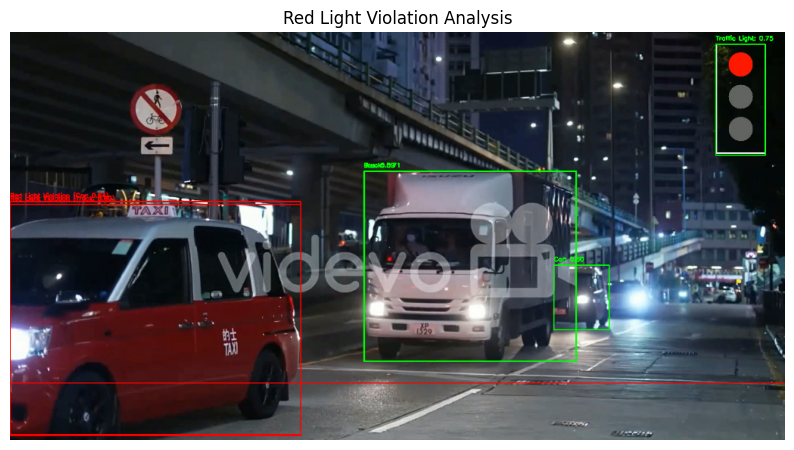

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:09:58] "POST /analyze HTTP/1.1" 200 -


0: 352x640 3 persons, 2 cars, 2 buss, 1 truck, 2 traffic lights, 2549.6ms
Speed: 3.5ms preprocess, 2549.6ms inference, 2.1ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.81 at [719, 304, 1344, 861]
Detected Object: Car: 0.79 at [1377, 616, 1513, 731]
Detected Object: Traffic Light: 0.79 at [1748, 30, 1871, 305]
Detected Object: Traffic Light: 0.73 at [520, 202, 599, 390]
Detected Object: Person: 0.57 at [820, 476, 912, 566]
Detected Object: Bus: 0.51 at [144, 382, 495, 701]
Bounding Box [719, 304, 1344, 861]: Truck: 0.81
Bounding Box [1377, 616, 1513, 731]: Car: 0.79
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.79
Bounding Box [520, 202, 599, 390]: Traffic Light: 0.73
Bounding Box [820, 476, 912, 566]: Person: 0.57
Bounding Box [144, 382, 495, 701]: Bus: 0.51


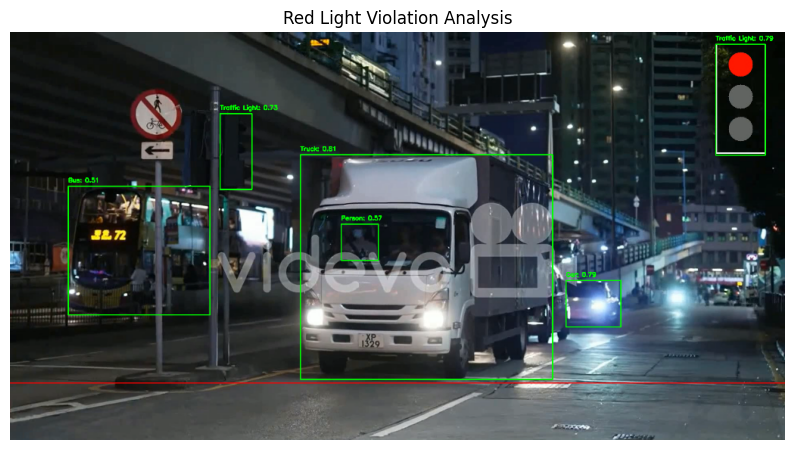

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:00] "POST /analyze HTTP/1.1" 200 -


0: 352x640 3 persons, 3 cars, 1 bus, 2 trucks, 2 traffic lights, 2425.2ms
Speed: 6.8ms preprocess, 2425.2ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.81 at [731, 303, 1354, 849]
Detected Object: Traffic Light: 0.76 at [1748, 31, 1871, 304]
Detected Object: Person: 0.73 at [820, 473, 931, 562]
Detected Object: Car: 0.65 at [1, 415, 519, 997]
Detected Object: Car: 0.59 at [1299, 574, 1437, 752]
Detected Object: Traffic Light: 0.53 at [518, 191, 599, 383]
Bounding Box [731, 303, 1354, 849]: Truck: 0.81
Bounding Box [1748, 31, 1871, 304]: Traffic Light: 0.76
Bounding Box [820, 473, 931, 562]: Person: 0.73
Bounding Box [1, 415, 519, 997]: Red Light Violation (Car: 0.65)
Bounding Box [1299, 574, 1437, 752]: Car: 0.59
Bounding Box [518, 191, 599, 383]: Traffic Light: 0.53


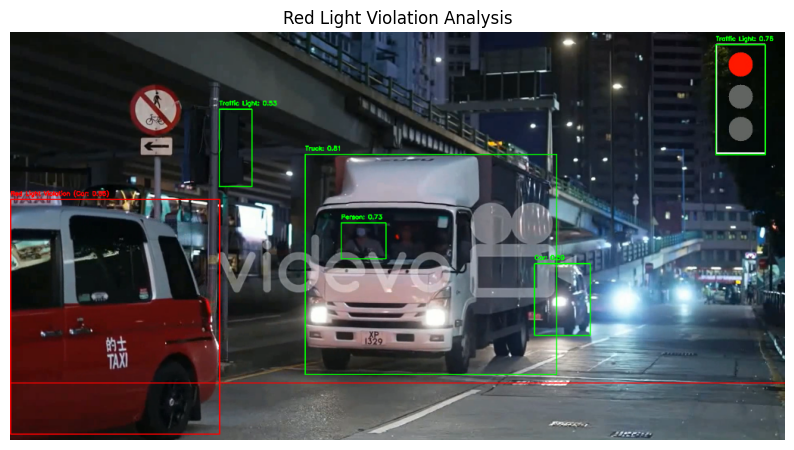

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:02] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 persons, 2 cars, 1 bus, 1 truck, 2 traffic lights, 2304.2ms
Speed: 11.1ms preprocess, 2304.2ms inference, 1.9ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.89 at [1, 425, 567, 996]
Detected Object: Traffic Light: 0.78 at [1748, 30, 1871, 304]
Detected Object: Car: 0.76 at [1291, 568, 1447, 749]
Detected Object: Person: 0.68 at [839, 477, 945, 561]
Detected Object: Truck: 0.62 at [749, 307, 1353, 844]
Detected Object: Traffic Light: 0.50 at [518, 189, 598, 381]
Bounding Box [1, 425, 567, 996]: Red Light Violation (Car: 0.89)
Bounding Box [1748, 30, 1871, 304]: Traffic Light: 0.78
Bounding Box [1291, 568, 1447, 749]: Car: 0.76
Bounding Box [839, 477, 945, 561]: Person: 0.68
Bounding Box [749, 307, 1353, 844]: Truck: 0.62
Bounding Box [518, 189, 598, 381]: Traffic Light: 0.50


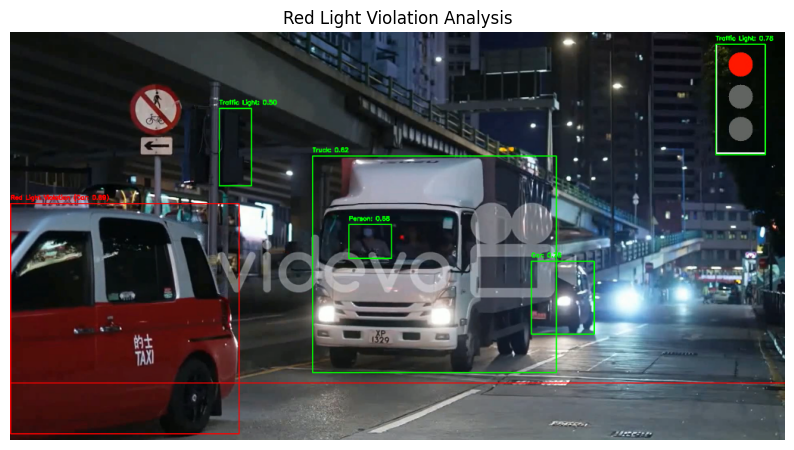

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:05] "POST /analyze HTTP/1.1" 200 -



0: 352x640 1 Traffic-Red, 292.8ms
Speed: 6.4ms preprocess, 292.8ms inference, 8.4ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 3 cars, 1 truck, 2 traffic lights, 2417.5ms
Speed: 3.8ms preprocess, 2417.5ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.93 at [1, 413, 379, 996]
Detected Object: Truck: 0.79 at [717, 300, 1345, 854]
Detected Object: Person: 0.76 at [805, 458, 919, 555]
Detected Object: Traffic Light: 0.71 at [1748, 30, 1870, 304]
Detected Object: Car: 0.71 at [1279, 566, 1413, 759]
Detected Object: Car: 0.71 at [1405, 611, 1538, 705]
Detected Object: Traffic Light: 0.69 at [519, 191, 600, 381]
Detected Object: Person: 0.58 at [930, 467, 1020, 562]
Bounding Box [1, 413, 379, 996]: Red Light Violation (Car: 0.93)
Bounding Box [717, 300, 1345, 854]: Truck: 0.79
Bounding Box [805, 458, 919, 555]: Person: 0.76
Bounding Box [1748, 30, 1870, 304]: T

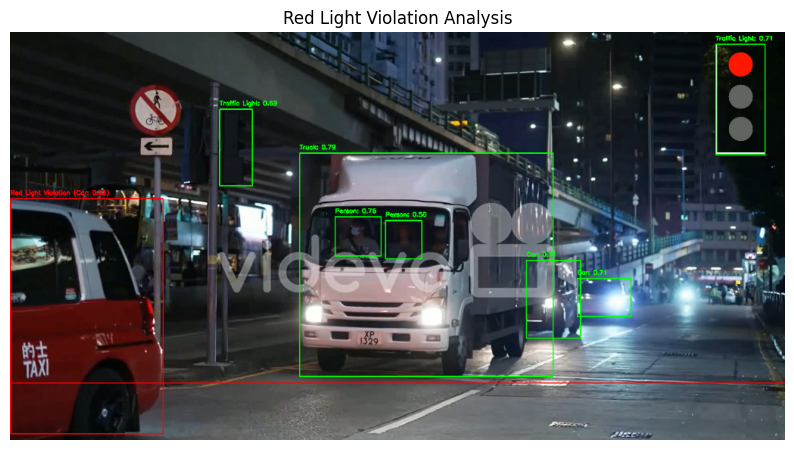

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:08] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 Traffic-Reds, 617.9ms
Speed: 15.0ms preprocess, 617.9ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 3 persons, 2 cars, 2 buss, 1 truck, 2 traffic lights, 3065.1ms
Speed: 3.9ms preprocess, 3065.1ms inference, 3.9ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.82 at [718, 302, 1345, 857]
Detected Object: Car: 0.79 at [1381, 612, 1520, 729]
Detected Object: Traffic Light: 0.79 at [1747, 30, 1871, 305]
Detected Object: Traffic Light: 0.71 at [520, 195, 599, 386]
Detected Object: Person: 0.64 at [816, 471, 919, 569]
Detected Object: Bus: 0.63 at [143, 382, 495, 698]
Bounding Box [718, 302, 1345, 857]: Truck: 0.82
Bounding Box [1381, 612, 1520, 729]: Car: 0.79
Bounding Box [1747, 30, 1871, 305]: Traffic Light: 0.79
Bounding Box [520, 195, 599, 386]: Traffic Light: 0.71
Bounding Box [816, 471, 919, 569]: Person: 0.64
Bounding Box [143, 382, 495, 698]: Bus: 0

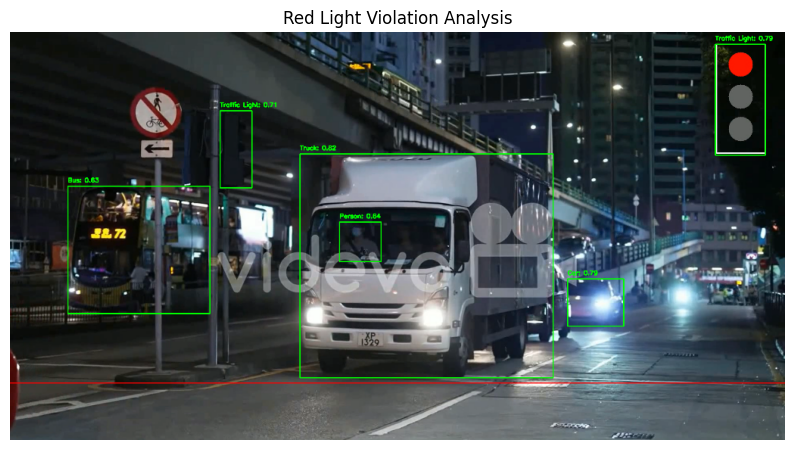

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:10] "POST /analyze HTTP/1.1" 200 -



0: 352x640 2 Traffic-Reds, 419.2ms
Speed: 13.1ms preprocess, 419.2ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 5 cars, 2 buss, 1 truck, 2 traffic lights, 2792.4ms
Speed: 3.9ms preprocess, 2792.4ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.86 at [959, 356, 1426, 792]
Detected Object: Car: 0.82 at [0, 446, 823, 997]
Detected Object: Car: 0.80 at [1377, 575, 1508, 723]
Detected Object: Traffic Light: 0.79 at [1748, 30, 1871, 305]
Detected Object: Traffic Light: 0.62 at [523, 187, 601, 372]
Detected Object: Bus: 0.60 at [153, 366, 486, 516]
Detected Object: Car: 0.60 at [1751, 619, 1803, 664]
Detected Object: Bus: 0.57 at [960, 356, 1425, 792]
Bounding Box [959, 356, 1426, 792]: Truck: 0.86
Bounding Box [0, 446, 823, 997]: Red Light Violation (Car: 0.82)
Bounding Box [1377, 575, 1508, 723]: Car: 0.80
Bounding Box [1748, 30, 1871, 305]

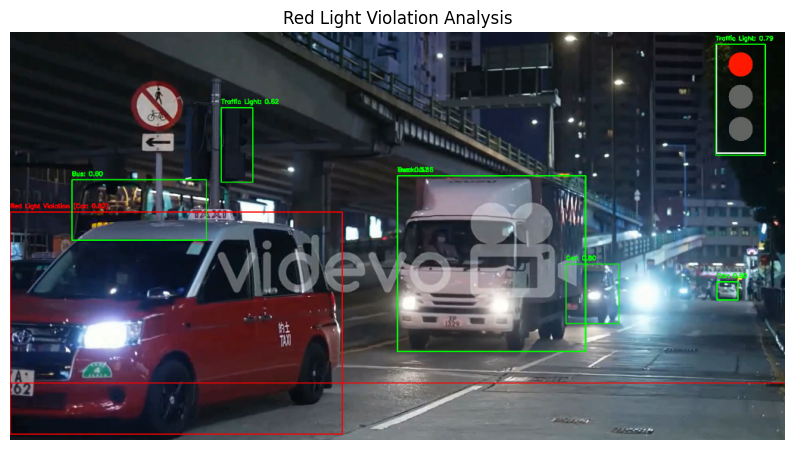

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:13] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 Traffic-Reds, 578.8ms
Speed: 15.0ms preprocess, 578.8ms inference, 6.6ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 Traffic-Reds, 404.4ms
Speed: 6.0ms preprocess, 404.4ms inference, 1.4ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 3 cars, 2 trucks, 2 traffic lights, 3032.6ms
Speed: 5.9ms preprocess, 3032.6ms inference, 2.3ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.83 at [715, 298, 1348, 854]
Detected Object: Car: 0.83 at [1277, 568, 1423, 757]
Detected Object: Traffic Light: 0.74 at [1748, 30, 1871, 304]
Detected Object: Person: 0.66 at [929, 465, 1022, 564]
Detected Object: Car: 0.64 at [0, 413, 443, 997]
Detected Object: Traffic Light: 0.63 at [518, 190, 598, 382]
Detected Object: Person: 0.58 at [807, 460, 918, 561]
Detected Object: Car: 0.5

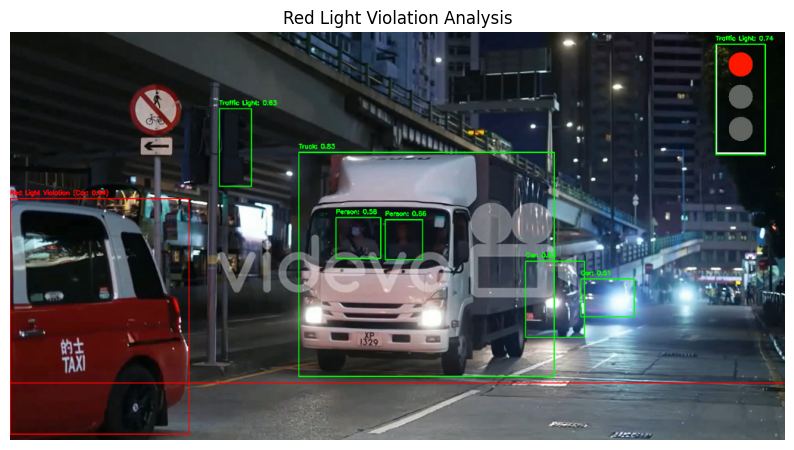

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:17] "POST /analyze HTTP/1.1" 200 -


0: 352x640 3 persons, 4 cars, 2 buss, 1 truck, 2 traffic lights, 3101.6ms
Speed: 7.5ms preprocess, 3101.6ms inference, 2.1ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.89 at [0, 424, 237, 998]
Detected Object: Car: 0.79 at [1391, 612, 1532, 725]
Detected Object: Traffic Light: 0.78 at [1748, 30, 1871, 304]
Detected Object: Traffic Light: 0.72 at [518, 192, 600, 382]
Detected Object: Person: 0.69 at [794, 457, 917, 560]
Detected Object: Truck: 0.61 at [718, 300, 1341, 854]
Detected Object: Bus: 0.55 at [718, 298, 1342, 856]
Detected Object: Car: 0.53 at [1279, 564, 1398, 764]
Detected Object: Bus: 0.50 at [150, 379, 493, 699]
Bounding Box [0, 424, 237, 998]: Red Light Violation (Car: 0.89)
Bounding Box [1391, 612, 1532, 725]: Car: 0.79
Bounding Box [1748, 30, 1871, 304]: Traffic Light: 0.78
Bounding Box [518, 192, 600, 382]: Traffic Light: 0.72
Bounding Box [794, 457, 917, 560]: Person: 0.69
Bounding Box [718, 300, 1341, 854]: Truck: 0.61
Bounding Box [718, 

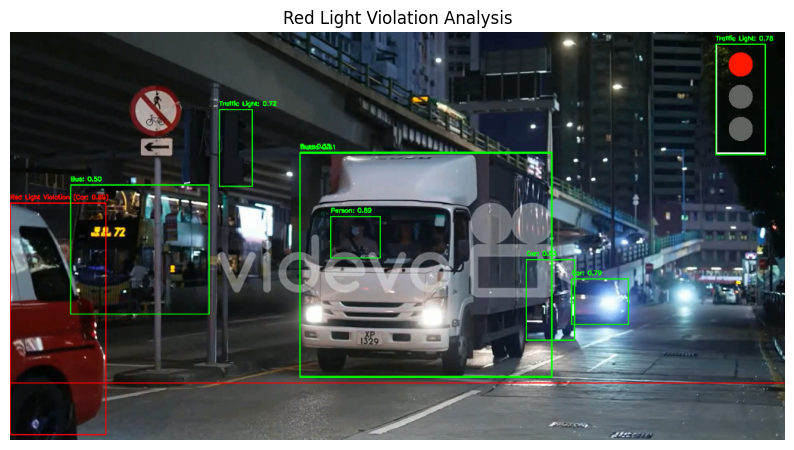

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:20] "POST /analyze HTTP/1.1" 200 -


0: 352x640 1 Traffic-Red, 652.6ms
Speed: 19.0ms preprocess, 652.6ms inference, 22.3ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED


0: 352x640 2 Traffic-Reds, 310.0ms
Speed: 7.4ms preprocess, 310.0ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED


0: 352x640 1 Traffic-Red, 356.8ms
Speed: 3.9ms preprocess, 356.8ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 2 cars, 1 bus, 2 trucks, 2 traffic lights, 3265.4ms
Speed: 3.9ms preprocess, 3265.4ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.90 at [833, 332, 1379, 826]
Detected Object: Traffic Light: 0.76 at [1748, 30, 1871, 305]
Detected Object: Car: 0.75 at [0, 438, 673, 998]
Detected Object: Person: 0.67 at [912, 477, 1009, 566]
Detected Object: 

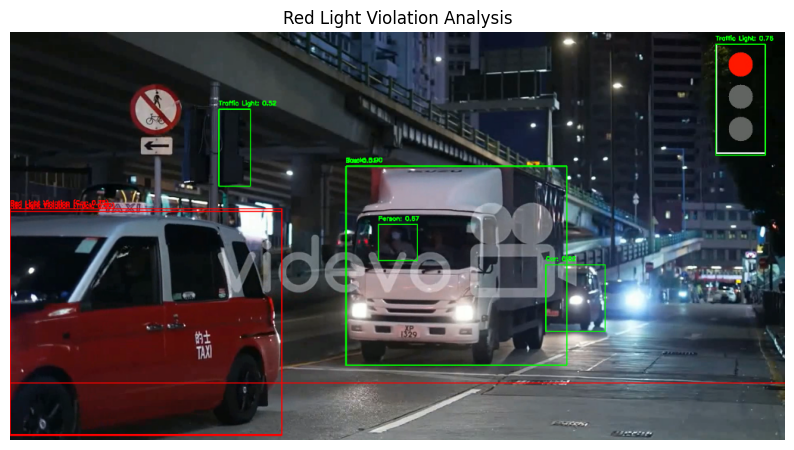

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:22] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 persons, 3 cars, 2 buss, 1 truck, 2 traffic lights, 2309.8ms
Speed: 8.2ms preprocess, 2309.8ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.90 at [0, 522, 133, 999]
Detected Object: Car: 0.81 at [1383, 614, 1524, 725]
Detected Object: Traffic Light: 0.77 at [1748, 30, 1871, 305]
Detected Object: Traffic Light: 0.77 at [518, 194, 599, 384]
Detected Object: Truck: 0.76 at [719, 301, 1343, 857]
Detected Object: Person: 0.67 at [816, 461, 921, 561]
Detected Object: Bus: 0.63 at [141, 380, 494, 693]
Bounding Box [0, 522, 133, 999]: Red Light Violation (Car: 0.90)
Bounding Box [1383, 614, 1524, 725]: Car: 0.81
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.77
Bounding Box [518, 194, 599, 384]: Traffic Light: 0.77
Bounding Box [719, 301, 1343, 857]: Truck: 0.76
Bounding Box [816, 461, 921, 561]: Person: 0.67
Bounding Box [141, 380, 494, 693]: Bus: 0.63


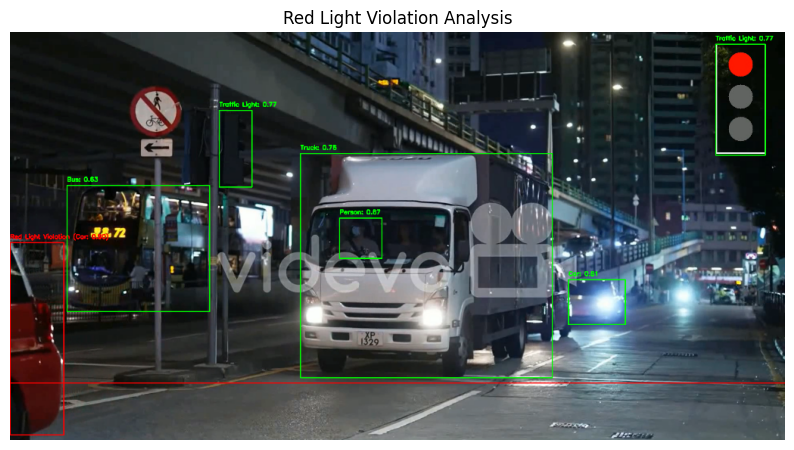

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:25] "POST /analyze HTTP/1.1" 200 -


0: 352x640 1 person, 4 cars, 1 bus, 2 trucks, 2 traffic lights, 2261.2ms
Speed: 3.5ms preprocess, 2261.2ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.84 at [1360, 575, 1497, 729]
Detected Object: Truck: 0.82 at [923, 351, 1411, 802]
Detected Object: Traffic Light: 0.78 at [1747, 30, 1871, 305]
Detected Object: Bus: 0.71 at [923, 351, 1409, 800]
Detected Object: Car: 0.69 at [1742, 622, 1812, 668]
Detected Object: Truck: 0.62 at [0, 424, 772, 998]
Detected Object: Car: 0.59 at [0, 413, 772, 996]
Bounding Box [1360, 575, 1497, 729]: Car: 0.84
Bounding Box [923, 351, 1411, 802]: Truck: 0.82
Bounding Box [1747, 30, 1871, 305]: Traffic Light: 0.78
Bounding Box [923, 351, 1409, 800]: Bus: 0.71
Bounding Box [1742, 622, 1812, 668]: Car: 0.69
Bounding Box [0, 424, 772, 998]: Red Light Violation (Truck: 0.62)
Bounding Box [0, 413, 772, 996]: Red Light Violation (Car: 0.59)


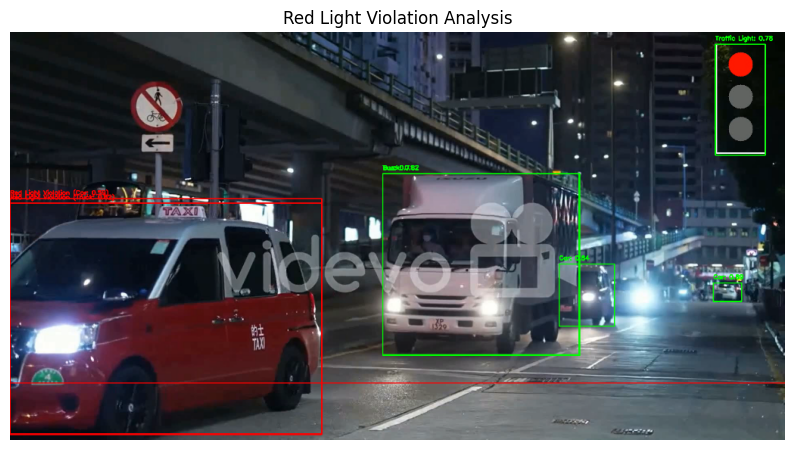

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:27] "POST /analyze HTTP/1.1" 200 -


0: 352x640 3 persons, 3 cars, 1 truck, 2 traffic lights, 2277.5ms
Speed: 9.3ms preprocess, 2277.5ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.88 at [782, 318, 1360, 837]
Detected Object: Traffic Light: 0.77 at [1748, 30, 1871, 305]
Detected Object: Car: 0.77 at [1, 419, 618, 998]
Detected Object: Car: 0.64 at [1345, 575, 1459, 743]
Detected Object: Person: 0.64 at [864, 472, 966, 559]
Bounding Box [782, 318, 1360, 837]: Truck: 0.88
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.77
Bounding Box [1, 419, 618, 998]: Red Light Violation (Car: 0.77)
Bounding Box [1345, 575, 1459, 743]: Car: 0.64
Bounding Box [864, 472, 966, 559]: Person: 0.64


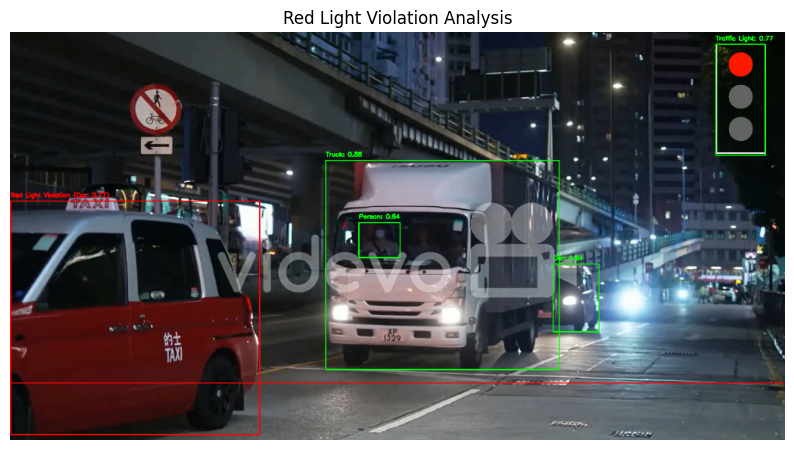

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:29] "POST /analyze HTTP/1.1" 200 -


0: 352x640 5 persons, 1 car, 2 buss, 1 truck, 2 traffic lights, 2357.0ms
Speed: 5.7ms preprocess, 2357.0ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.84 at [1376, 618, 1511, 737]
Detected Object: Traffic Light: 0.82 at [1748, 30, 1872, 304]
Detected Object: Truck: 0.79 at [719, 304, 1349, 861]
Detected Object: Bus: 0.70 at [142, 383, 699, 708]
Detected Object: Traffic Light: 0.62 at [520, 202, 598, 392]
Detected Object: Person: 0.61 at [820, 472, 913, 568]
Bounding Box [1376, 618, 1511, 737]: Car: 0.84
Bounding Box [1748, 30, 1872, 304]: Traffic Light: 0.82
Bounding Box [719, 304, 1349, 861]: Truck: 0.79
Bounding Box [142, 383, 699, 708]: Bus: 0.70
Bounding Box [520, 202, 598, 392]: Traffic Light: 0.62
Bounding Box [820, 472, 913, 568]: Person: 0.61


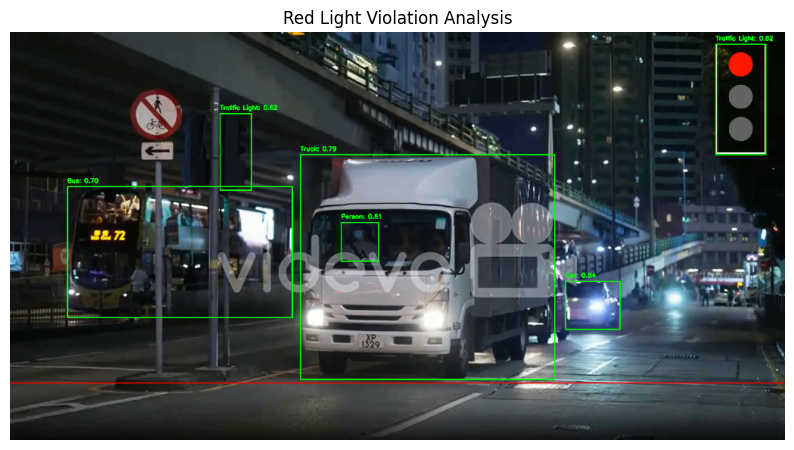

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:32] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 persons, 4 cars, 1 bus, 1 truck, 2 traffic lights, 2512.8ms
Speed: 3.9ms preprocess, 2512.8ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.93 at [0, 414, 299, 996]
Detected Object: Traffic Light: 0.74 at [1748, 30, 1870, 304]
Detected Object: Car: 0.70 at [1279, 563, 1405, 763]
Detected Object: Traffic Light: 0.68 at [518, 192, 599, 382]
Detected Object: Person: 0.67 at [801, 458, 915, 558]
Detected Object: Car: 0.65 at [1398, 611, 1534, 716]
Detected Object: Truck: 0.60 at [717, 300, 1343, 854]
Detected Object: Bus: 0.59 at [718, 297, 1343, 856]
Bounding Box [0, 414, 299, 996]: Red Light Violation (Car: 0.93)
Bounding Box [1748, 30, 1870, 304]: Traffic Light: 0.74
Bounding Box [1279, 563, 1405, 763]: Car: 0.70
Bounding Box [518, 192, 599, 382]: Traffic Light: 0.68
Bounding Box [801, 458, 915, 558]: Person: 0.67
Bounding Box [1398, 611, 1534, 716]: Car: 0.65
Bounding Box [717, 300, 1343, 854]: Truck: 0.60
Bounding Box [718, 297, 

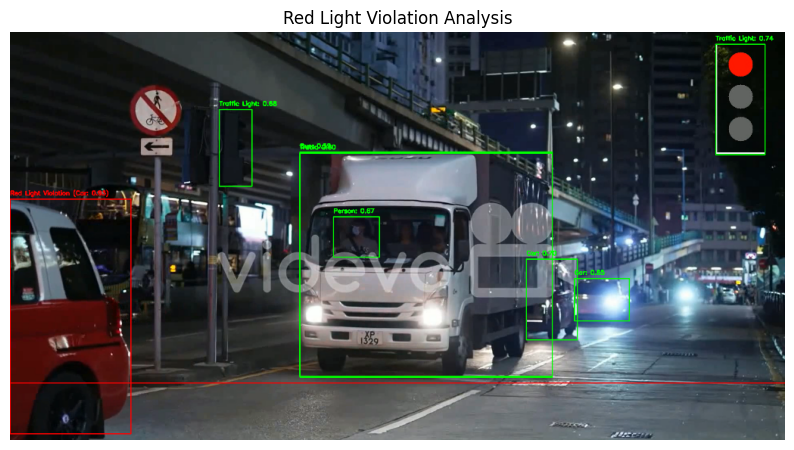

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:34] "POST /analyze HTTP/1.1" 200 -


0: 352x640 3 persons, 2 cars, 3 buss, 1 truck, 2 traffic lights, 2510.6ms
Speed: 3.9ms preprocess, 2510.6ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.82 at [720, 303, 1345, 861]
Detected Object: Traffic Light: 0.79 at [1748, 30, 1871, 305]
Detected Object: Car: 0.79 at [1376, 616, 1513, 735]
Detected Object: Traffic Light: 0.73 at [521, 202, 599, 391]
Detected Object: Person: 0.56 at [820, 476, 912, 566]
Detected Object: Bus: 0.56 at [143, 381, 693, 710]
Bounding Box [720, 303, 1345, 861]: Truck: 0.82
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.79
Bounding Box [1376, 616, 1513, 735]: Car: 0.79
Bounding Box [521, 202, 599, 391]: Traffic Light: 0.73
Bounding Box [820, 476, 912, 566]: Person: 0.56
Bounding Box [143, 381, 693, 710]: Bus: 0.56


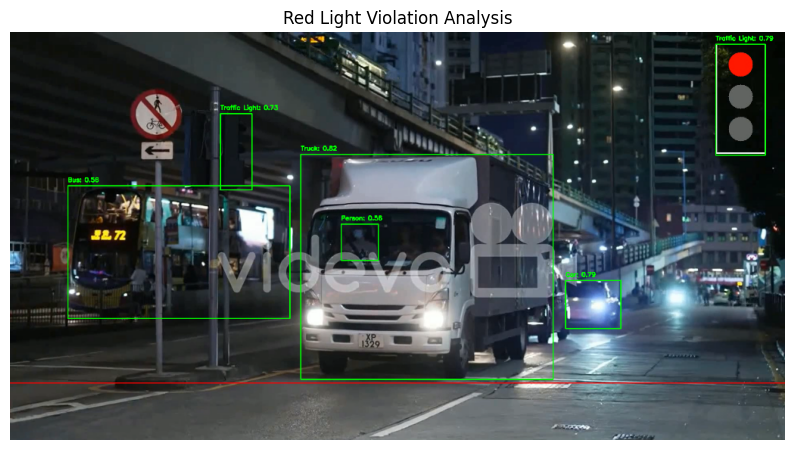

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:37] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 persons, 2 cars, 1 bus, 2 trucks, 2 traffic lights, 2264.2ms
Speed: 5.5ms preprocess, 2264.2ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.78 at [1347, 577, 1484, 738]
Detected Object: Truck: 0.74 at [873, 342, 1397, 817]
Detected Object: Truck: 0.74 at [0, 430, 715, 999]
Detected Object: Traffic Light: 0.74 at [1748, 30, 1871, 305]
Detected Object: Person: 0.65 at [952, 483, 1032, 556]
Detected Object: Person: 0.53 at [1050, 490, 1136, 578]
Detected Object: Traffic Light: 0.52 at [518, 188, 599, 381]
Bounding Box [1347, 577, 1484, 738]: Car: 0.78
Bounding Box [873, 342, 1397, 817]: Truck: 0.74
Bounding Box [0, 430, 715, 999]: Red Light Violation (Truck: 0.74)
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.74
Bounding Box [952, 483, 1032, 556]: Person: 0.65
Bounding Box [1050, 490, 1136, 578]: Person: 0.53
Bounding Box [518, 188, 599, 381]: Traffic Light: 0.52


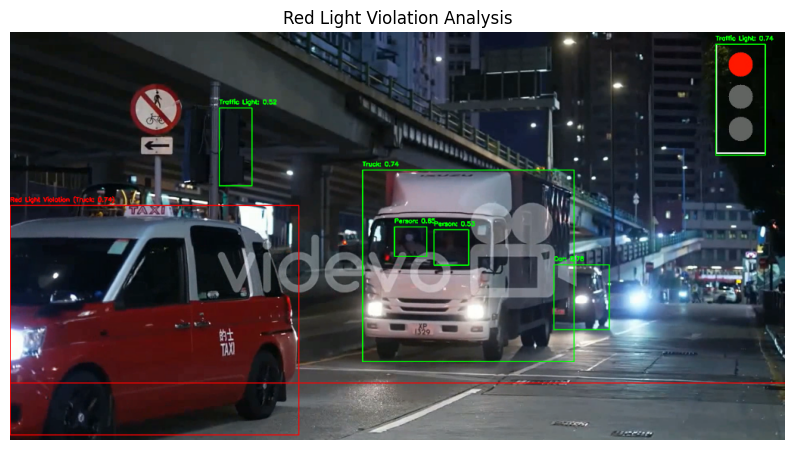

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:39] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 persons, 3 cars, 2 trucks, 2 traffic lights, 2319.3ms
Speed: 3.6ms preprocess, 2319.3ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.86 at [729, 302, 1355, 849]
Detected Object: Traffic Light: 0.76 at [1748, 30, 1871, 305]
Detected Object: Person: 0.71 at [818, 473, 930, 560]
Detected Object: Car: 0.69 at [1283, 572, 1436, 753]
Detected Object: Car: 0.57 at [0, 413, 512, 996]
Detected Object: Truck: 0.55 at [1, 410, 512, 996]
Detected Object: Traffic Light: 0.54 at [518, 191, 599, 383]
Bounding Box [729, 302, 1355, 849]: Truck: 0.86
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.76
Bounding Box [818, 473, 930, 560]: Person: 0.71
Bounding Box [1283, 572, 1436, 753]: Car: 0.69
Bounding Box [0, 413, 512, 996]: Red Light Violation (Car: 0.57)
Bounding Box [1, 410, 512, 996]: Red Light Violation (Truck: 0.55)
Bounding Box [518, 191, 599, 383]: Traffic Light: 0.54


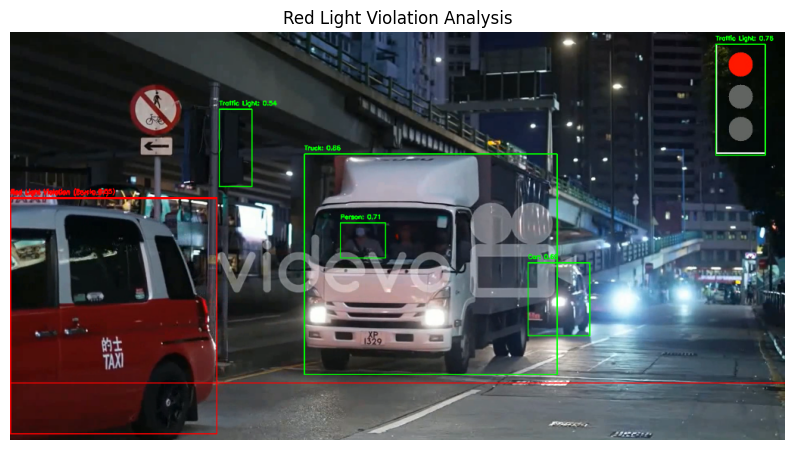

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:41] "POST /analyze HTTP/1.1" 200 -



0: 352x640 1 Traffic-Red, 179.9ms
Speed: 6.8ms preprocess, 179.9ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 1 person, 3 cars, 1 truck, 2 traffic lights, 1605.1ms
Speed: 3.8ms preprocess, 1605.1ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.79 at [1288, 570, 1445, 750]
Detected Object: Traffic Light: 0.77 at [1748, 30, 1871, 304]
Detected Object: Truck: 0.73 at [745, 306, 1353, 844]
Detected Object: Car: 0.72 at [0, 427, 561, 996]
Detected Object: Person: 0.68 at [836, 473, 941, 559]
Bounding Box [1288, 570, 1445, 750]: Car: 0.79
Bounding Box [1748, 30, 1871, 304]: Traffic Light: 0.77
Bounding Box [745, 306, 1353, 844]: Truck: 0.73
Bounding Box [0, 427, 561, 996]: Red Light Violation (Car: 0.72)
Bounding Box [836, 473, 941, 559]: Person: 0.68


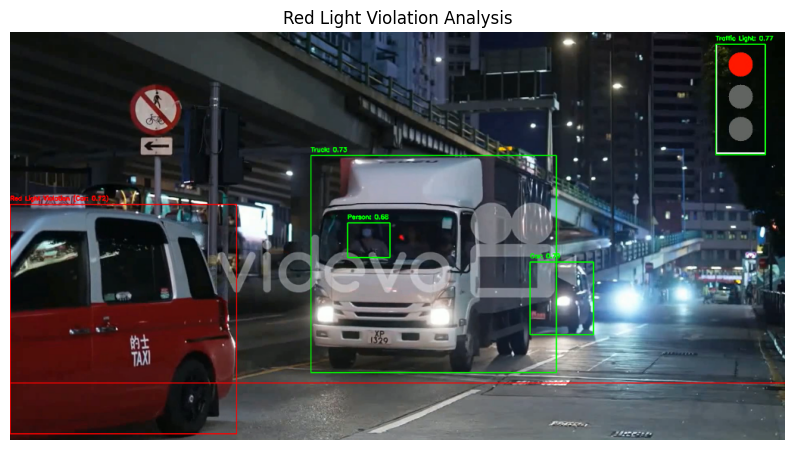

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:10:56] "POST /analyze HTTP/1.1" 200 -



0: 352x640 2 Traffic-Reds, 205.3ms
Speed: 5.7ms preprocess, 205.3ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 3 cars, 2 buss, 1 truck, 2 traffic lights, 1635.0ms
Speed: 3.8ms preprocess, 1635.0ms inference, 4.0ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.89 at [0, 555, 120, 999]
Detected Object: Car: 0.82 at [1381, 613, 1524, 728]
Detected Object: Truck: 0.77 at [718, 301, 1342, 857]
Detected Object: Traffic Light: 0.77 at [518, 196, 599, 385]
Detected Object: Traffic Light: 0.76 at [1748, 30, 1871, 305]
Detected Object: Bus: 0.69 at [140, 381, 493, 697]
Detected Object: Person: 0.61 at [816, 464, 918, 560]
Bounding Box [0, 555, 120, 999]: Red Light Violation (Car: 0.89)
Bounding Box [1381, 613, 1524, 728]: Car: 0.82
Bounding Box [718, 301, 1342, 857]: Truck: 0.77
Bounding Box [518, 196, 599, 385]: Traffic Light: 0.77
Bounding Box [1748, 30, 1871, 3

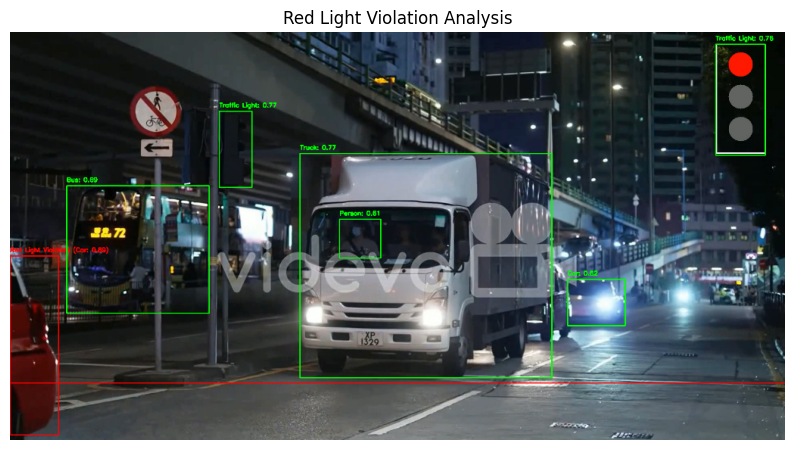

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:11:32] "POST /analyze HTTP/1.1" 200 -



0: 352x640 1 Traffic-Red, 173.9ms
Speed: 5.2ms preprocess, 173.9ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 2 persons, 3 cars, 1 truck, 2 traffic lights, 1621.3ms
Speed: 3.5ms preprocess, 1621.3ms inference, 1.4ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.93 at [1, 412, 371, 997]
Detected Object: Person: 0.75 at [803, 458, 920, 554]
Detected Object: Truck: 0.73 at [717, 300, 1342, 854]
Detected Object: Traffic Light: 0.72 at [1748, 30, 1870, 304]
Detected Object: Car: 0.71 at [1404, 610, 1536, 710]
Detected Object: Car: 0.67 at [1280, 565, 1412, 759]
Detected Object: Traffic Light: 0.66 at [518, 192, 600, 382]
Bounding Box [1, 412, 371, 997]: Red Light Violation (Car: 0.93)
Bounding Box [803, 458, 920, 554]: Person: 0.75
Bounding Box [717, 300, 1342, 854]: Truck: 0.73
Bounding Box [1748, 30, 1870, 304]: Traffic Light: 0.72
Bounding Box [1404, 610, 1536, 710]:

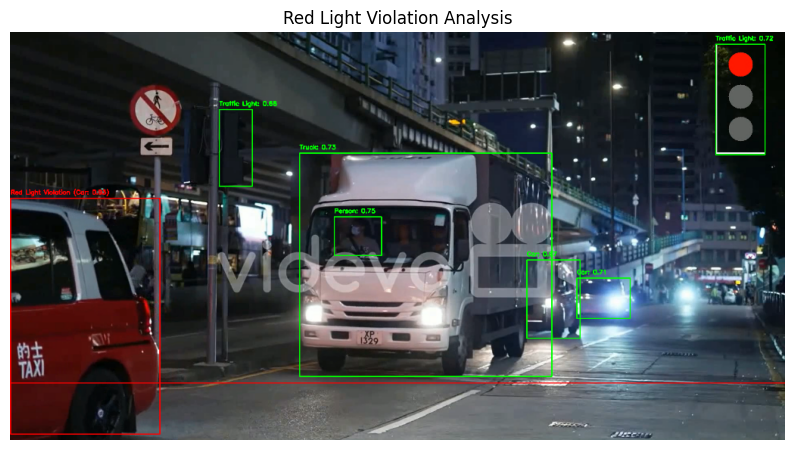

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:11:37] "POST /analyze HTTP/1.1" 200 -



0: 352x640 1 Traffic-Red, 190.0ms
Speed: 5.7ms preprocess, 190.0ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED


0: 352x640 2 Traffic-Reds, 377.9ms
Speed: 3.9ms preprocess, 377.9ms inference, 1.1ms postprocess per image at shape (1, 3, 352, 640)
Current Detected State: RED
Detected traffic light state: RED

0: 352x640 3 persons, 2 cars, 2 buss, 1 truck, 2 traffic lights, 1924.7ms
Speed: 5.8ms preprocess, 1924.7ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Car: 0.81 at [1381, 611, 1521, 732]
Detected Object: Truck: 0.80 at [718, 302, 1344, 857]
Detected Object: Traffic Light: 0.79 at [1747, 30, 1871, 305]
Detected Object: Traffic Light: 0.70 at [520, 195, 600, 386]
Detected Object: Person: 0.65 at [816, 470, 919, 567]
Detected Object: Bus: 0.64 at [143, 382, 494, 697]
Bounding Box [1381, 611, 1521, 732]: Car: 0.81
Bounding Box [718, 302, 1344, 857]: Truck: 0.80
Boun

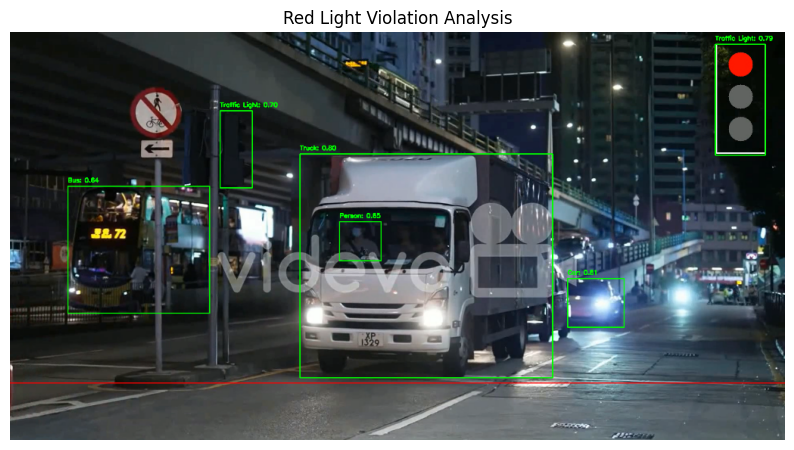

INFO:werkzeug:127.0.0.1 - - [22/Nov/2024 23:11:44] "POST /analyze HTTP/1.1" 200 -


0: 352x640 2 persons, 3 cars, 1 bus, 2 trucks, 2 traffic lights, 2082.2ms
Speed: 3.9ms preprocess, 2082.2ms inference, 2.0ms postprocess per image at shape (1, 3, 352, 640)
Detected Object: Truck: 0.92 at [828, 331, 1376, 827]
Detected Object: Traffic Light: 0.76 at [1748, 30, 1871, 305]
Detected Object: Car: 0.71 at [0, 439, 667, 997]
Detected Object: Person: 0.63 at [909, 477, 1005, 566]
Detected Object: Car: 0.60 at [1334, 577, 1472, 742]
Detected Object: Truck: 0.54 at [0, 445, 668, 999]
Detected Object: Traffic Light: 0.50 at [517, 190, 595, 381]
Bounding Box [828, 331, 1376, 827]: Truck: 0.92
Bounding Box [1748, 30, 1871, 305]: Traffic Light: 0.76
Bounding Box [0, 439, 667, 997]: Red Light Violation (Car: 0.71)
Bounding Box [909, 477, 1005, 566]: Person: 0.63
Bounding Box [1334, 577, 1472, 742]: Car: 0.60
Bounding Box [0, 445, 668, 999]: Red Light Violation (Truck: 0.54)
Bounding Box [517, 190, 595, 381]: Traffic Light: 0.50
Buffered data was truncated after reaching the output s

In [ ]:

# Run Flask app - Run this cell to start server once after other setups are done
if __name__ == '__main__':
    app.run(port=5000)


# ***`Testing`***

In [ ]:
# Load an example frame for testing
image_path = "/content/frame_0313.png"  # Replace with the path to your test image
frame = cv2.imread(image_path)

if frame is not None:
    detected_vehicles = detect_vehicles(frame, yolo_model)
    print(f"Total Vehicles Detected: {len(detected_vehicles)}")
    for vehicle in detected_vehicles:
        print(vehicle)
else:
    print(f"Failed to load image from {image_path}")


In [ ]:
# Load an example frame for testing
image_path = "/content/frame_0094.png"  # Replace with the path to your test image
frame = cv2.imread(image_path)
model_path = "/content/best.pt"  # Replace with the actual path to your YOLOv11 model
trained_yolo_model = YOLO(model_path)
if frame is not None:
    light_detected = detect_traffic_light_state(frame, yolo_model)
    print(f"traffic light Detected: {light_detected}")
else:
    print(f"Failed to load image from {image_path}")